In [2]:
import sys

sys.path.append("..")

%load_ext autoreload
%autoreload complete

In [3]:
from itertools import pairwise

import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import xarray as xr
import numpy as np
from dask.distributed import Client
import dask
import pandas as pd
import matplotlib as mpl
import seaborn as sns

from lmrecon.datasets import *
from lmrecon.util import get_data_path, get_base_path
from lmrecon.stats import (
    area_weighted_mean,
    rmse,
    mse,
    average_seasonally,
    average_annually,
    anomalize,
    regress_field,
)
from lmrecon.plotting import plot_field, add_subplot_headers, format_plot, get_field_label, get_field_unit, subplots_cartopy, shade_ci, use_zero_ylim, use_zero_xlim, get_field_scaling
from lmrecon.units import calculate_siarea, calculate_sistatistic, calculate_sistatistics, convert_ohc_per_ocean_area_to_total_ohc
from lmrecon.signal import lowpass_filter, compute_spectrum_multitaper
from lmrecon.time import add_season_coords, Season, use_tuple_time_coords, use_enum_season_coords, use_decimal_year_time_coords
from lmrecon.indices import Nino34Index, AMOIndex, PDOIndex, IPOTripoleIndex

In [4]:
# client = Client(n_workers=dask.system.CPU_COUNT // 2, threads_per_worker=1)

In [6]:
# models = ["MPI-ESM1-2-LR", "CESM2", "MRI-ESM2-0"]
# models = ["MPI-ESM1-2-LR", "MRI-ESM2-0", "MIROC-ES2L"]
models = ["MPI-ESM1-2-LR", "CESM2", "MRI-ESM2-0", "MIROC-ES2L"]

In [7]:
dss = []
dss_anom = []
for model in models:
    # experiment = "historical"
    # experiment = "past2k" if model.startswith("MPI") else "past1000"
    experiment = "past2k_historical" if model.startswith("MPI") else "past1000_historical"
    ds = xr.open_zarr(get_data_path() / "cmip6" / model / experiment / "seasonal_averages.zarr").sel(time=slice(800, None))
    ds = xr.merge([ds, calculate_sistatistics(ds)])
    dss.append(ds)
    dss_anom.append(xr.open_zarr(get_data_path() / "cmip6" / model / experiment / "seasonal_anomalies.zarr").sel(time=slice(800, None)))
mmm = xr.open_zarr(get_data_path() / "cmip6" / "mmm" / "past1000_historical" / "seasonal_averages.zarr")
mmm_anom = xr.open_zarr(get_data_path() / "cmip6" / "mmm" / "past1000_historical" / "seasonal_anomalies.zarr")

In [8]:
ds_sic = load_cdr_sic()
ds_satire = load_satire_solar()
ds_ersst = load_ersst(False)
ds_hadisst = load_hadisst(False)
ds_cobesst = load_cobesst(False)
ds_cooper25 = load_cooper25()
ds_gistemp = load_gistemp()
ds_hadcrut = load_hadcrut()
ds_era5 = load_era5(False)
ds_evolv2k = load_evolv2k()
ds_wu25 = load_wu2025()

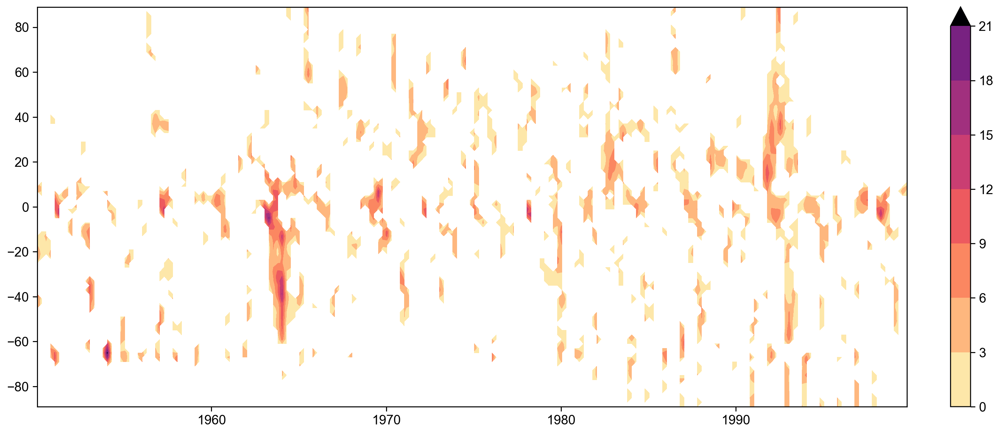

In [ ]:
fig, ax = plt.subplots()
x = dss_anom[1]["rsut"].mean("lon").transpose("lat", "time").sel(time=slice(1950, 2000))
x = x.where(x >= 1)
cs = ax.contourf(x.time, x.lat, x, cmap="magma_r", vmax=30, extend="max")
plt.colorbar(cs, ax=ax)

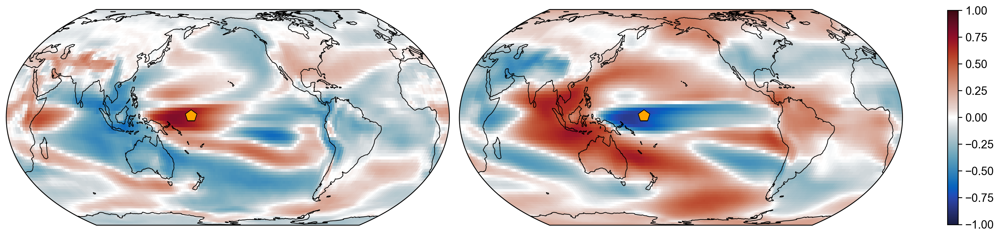

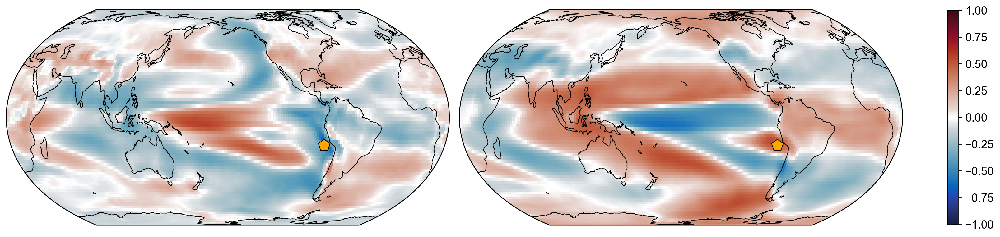

In [ ]:
def plot_corr(lat, lon):
    x = dss_anom[1].sel(time=slice(850, 1850))
    # x = average_annually(x)
    corr_rsut = xr.corr(
        x.sel(lat=lat, lon=lon)["tas"],
        x["rsut"],
        "time"
    )
    corr_rlut = xr.corr(
        x.sel(lat=lat, lon=lon)["tas"],
        x["rlut"],
        "time"
    )

    fig, axs = subplots_cartopy(1, 2)
    plot_field(axs, [corr_rsut, corr_rlut], vmin=-1, vmax=1,
               cbar_orientation="vertical", cbar_kwargs={"shrink": 0.7}, extend="neither")
    for ax in axs:
        ax.scatter(lon, lat, transform=ccrs.PlateCarree(),
                   marker="p", s=200, c="orange", edgecolor="black")

plot_corr(1, 170)

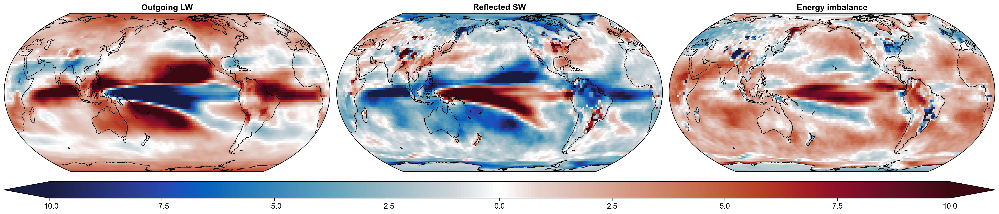

In [ ]:
fig, axs = subplots_cartopy(1, 3)
# x = mmm_anom
x = dss_anom[2]
plot_field(
    axs,
    # [xr.corr(mmm_anom[f], area_weighted_mean(mmm_anom["tas"]), "time") for f in ["rlut", "rsut", "eei"]],
    [(regress_field(x[f], area_weighted_mean(x["tas"]))) for f in ["rlut", "rsut", "eei"]],
    # [(regress_field(mmm_anom[f], area_weighted_mean(mmm_anom["tas"])) / mmm_anom[f].std("time")) for f in ["rlut", "rsut", "eei"]],
    colorbar=True,
    vmin=-10, vmax=10
)
for ax, f in zip(axs, ["rlut", "rsut", "eei"]):
    ax.set_title(get_field_label(f))
plt.show()

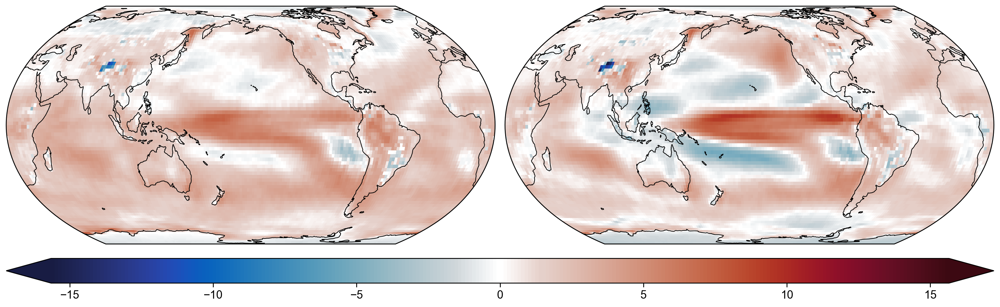

In [ ]:
from lmrecon.stats import regress_field


fig, axs = subplots_cartopy(1, 2)

c1 = regress_field(mmm_anom["eei"], area_weighted_mean(mmm_anom["tas"]))
c2 = xr.concat([
    regress_field(dss_anom[i]["eei"], area_weighted_mean(dss_anom[i]["tas"])) for i in range(3)
], dim="model").mean("model")

plot_field(axs, [c1, c2])

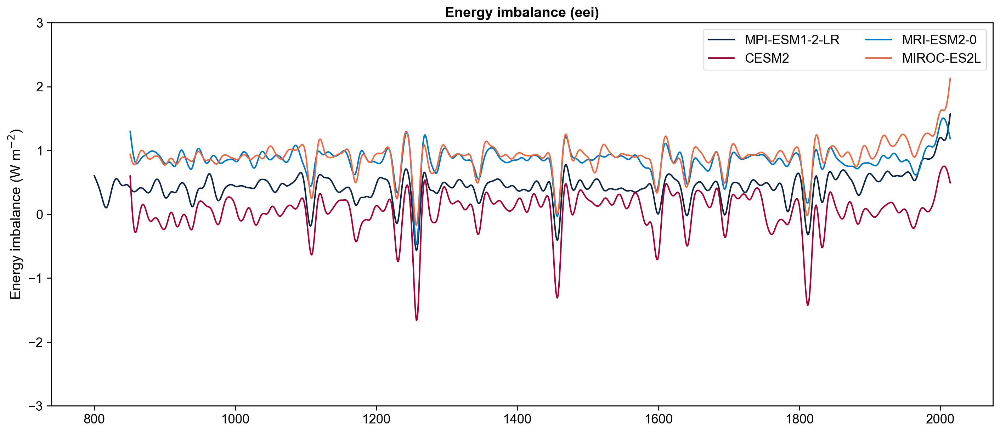

In [ ]:
def compare_global_mean(field):
    fig, ax = plt.subplots()

    units = get_field_unit(field)
    if field == "rsdt":
        solar = ds_satire
        ax.plot(solar.time, solar["tsi"] / 4, label="SATIRE-M solar forcing", lw=3, c="black")

    for ds, label in zip(dss, models):
        ds = area_weighted_mean(ds[field])
        ds = average_annually(ds)
        ds = lowpass_filter(ds, 20)
        if field in ["tas", "tos"]:
            ds -= 273.15
            units = "°C"
        if field == "tas":
            trend = ds.sel(time=slice(850, 1850)).polyfit("time", 1)["polyfit_coefficients"].values[0]
            label = f"{label} (850-1850 trend: {trend*1e3:+.2f} K/kyr)"
        ax.plot(ds.time, ds, label=label)
    
    if field == "tas":
        ds = area_weighted_mean(ds_era5[field]) - 273.15
        # ds = average_annually(ds)
        ds = lowpass_filter(ds, 20)
        ax.plot(ds.time, ds, ls="--", c="black", label="ERA5")



    ax.set_ylabel(f"{get_field_label(field)} ({units})")
    ax.set_title(f"{get_field_label(field)} ({field})")
    # ax.set_xlim(1700, 1850)
    # ax.set_xlim(850, 2000)
    # ax.set_xticks(np.arange(900, 2001, 100))
    # ax.set_xlim(1250, 1270)
    # ax.set_xlim(1850, 2000)
    ax.set_ylim({
            "tas": (12.3, 16),
            "tos": (16.5, 19.5),
            "rsdt": (335, 345),
            "eei": (-3, 3)
        }.get(field, (None, None)))
    ax.legend(ncols=2)

# compare_global_mean("tas")
compare_global_mean("eei")
# compare_global_mean("rsut")
# compare_global_mean("rlut")
# compare_global_mean("rsdt")
# compare_global_mean("tos")

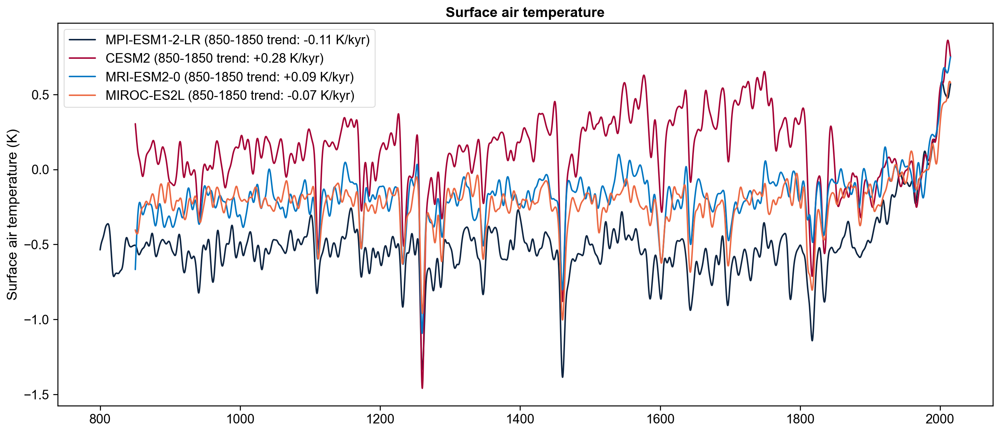

In [14]:
def compare_global_mean_anomaly(field):
    fig, ax = plt.subplots()

    for ds, label in zip(dss_anom, models):
        ds = area_weighted_mean(ds[field])
        # ds = average_annually(ds)
        # ds = anomalize(ds, (1870, 1900)).sel(time=slice(1850, 2000))
        # ds = anomalize(ds, (850, 1850)).sel(time=slice(1850, 2000))
        ds = lowpass_filter(ds, 10)
        if field == "tas":
            trend = ds.sel(time=slice(850, 1850)).polyfit("time", 1)["polyfit_coefficients"].values[0]
            label = f"{label} (850-1850 trend: {trend*1e3:+.2f} K/kyr)"
        ax.plot(ds.time, ds, label=label)
    
    if field == "rsdt":
        solar = ds_satire
        solar = anomalize(ds_satire, (1961, 1991))
        ax.plot(solar.time, solar["tsi"] / 4, label="SATIRE-M solar forcing")

    if field == "eei":
        eei = ds_wu25["eei"]
        eei = anomalize(eei, (1870, 1900))
        eei = lowpass_filter(eei, 10)
        ax.plot(eei.time, eei, label="Wu et al. (2025)")

    ax.set_ylabel(get_field_label(field, True))
    ax.set_title(get_field_label(field))
    # ax.set_xlim(1850, 2000)
    # ax.set_xticks(np.arange(900, 2001, 100))
    # ax.set_xlim(1250, 1270)
    # ax.set_xlim(1700, 1850)
    # ax.set_ylim({
    #         "tas": (-1.5, 1.0),
    #         "tos": (-0.7, 0.55),
    #         "rsut": (-4, 5),
    #         "rlut": (-3, 3),
    #         "eei": (-2, 1.5),
    #         "rsdt": (-0.35, 0.25),
    #         "ohc700": (-1000e6, 550e6),
    #         "ohc300": (-7e8, +3e8)
    #     }[field])
    ax.legend()
    plt.show()

compare_global_mean_anomaly("tas")
# compare_global_mean_anomaly("tos")
# compare_global_mean_anomaly("ohc300")
# compare_global_mean_anomaly("ohc700")
# compare_global_mean_anomaly("rsdt")
# compare_global_mean_anomaly("eei")
# compare_global_mean_anomaly("rlut")
# compare_global_mean_anomaly("rsut")

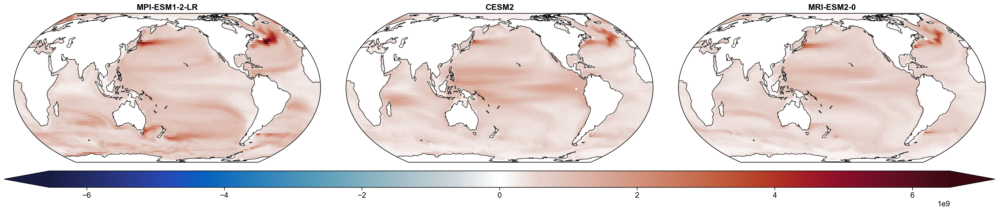

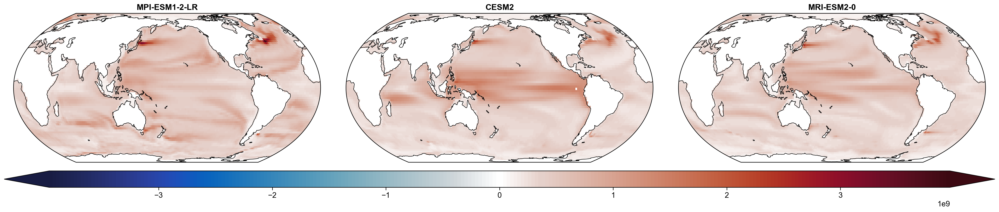

In [ ]:
def compare_ohc_distribution(field):
    fig, axs = subplots_cartopy(1, len(dss_anom))

    plot_field(axs, [
        (ds[field] - area_weighted_mean(ds[field])).std("time") for ds in dss_anom
    ], plot_method="pcolormesh")
    for ax, model in zip(axs, models):
        ax.set_title(model)

compare_ohc_distribution("ohc700")
compare_ohc_distribution("ohc300")

In [ ]:
hybrid_vince = xr.open_dataset(
        get_base_path() / "datasets/climo_vince/hybrid_siconc_1961-1990.nc"
    )
hybrid_climo_vince = use_enum_season_coords(
    xr.open_dataset(
        get_base_path() / "datasets/climo_vince/climatology_hybrid_siconc_1961-1990.nc"
    )
)
hybrid_climo_mine = use_enum_season_coords(
    xr.open_dataset(
        get_data_path() / "cmip6" / "mmm" / "past1000_historical" / "climatology_hybrid_siconc_1961-1990.nc"
    )
)

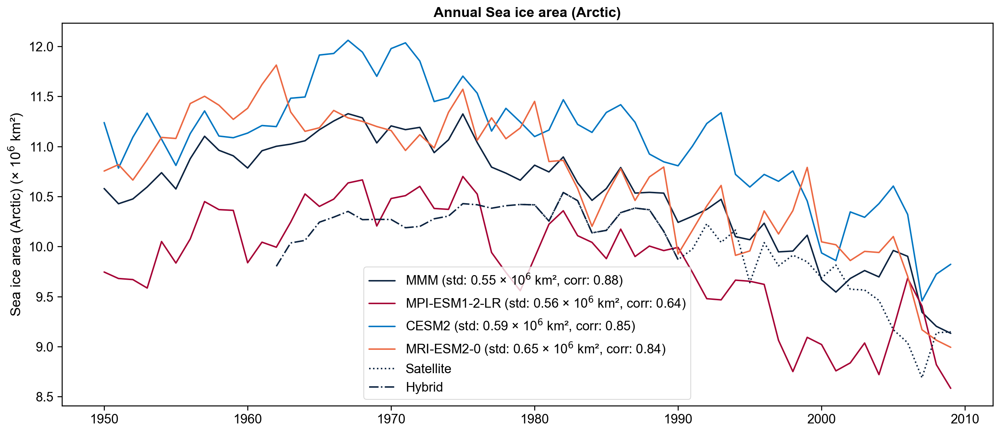

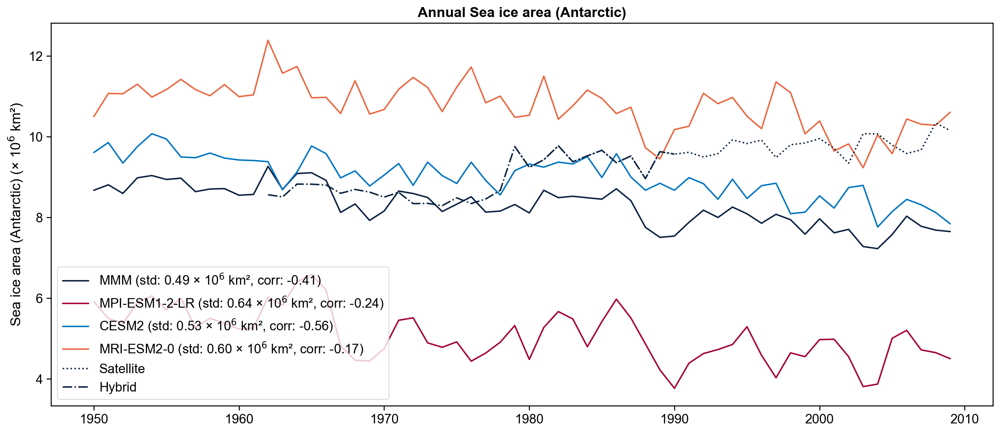

In [ ]:
def plot_siarea(field, type="annual"):
    def _select(ds):
        ds = ds.sel(time=slice(1950, 2010)) / 1e6
        if type == "annual":
            return average_annually(ds)
        else:
            return ds.sel(time=add_season_coords(ds).season == type)

    fig, ax = plt.subplots()

    for model, ds in zip(["MMM"] + models, [mmm] + dss):
        siarean = _select(ds[field])
        std = siarean.std("time").compute().item()
        corr = xr.corr(_select(ds_sic[field]), siarean).compute().item()
        # siarean = lowpass_filter(siarean, 20)
        ax.plot(siarean.time, siarean,
                 label=f"{model} (std: {std:.2f} × 10$^6$ km², corr: {corr:.2f})")
    
    sat = _select(ds_sic[field])
    ax.plot(sat.time, sat, label="Satellite", ls=":", c="C0")

    sat = _select(calculate_sistatistics(hybrid_vince)[field])
    ax.plot(sat.time, sat, label="Hybrid", ls="-.", c="C0")

    ax.set_ylabel(f"{get_field_label(field)} (× 10$^6$ km²)")

    if type == "annual":
        type = "Annual"
    else:
        type = type.name
    ax.set_title(f"{type} {get_field_label(field)}")
    
    ax.legend()

type = "annual"
# type = Season.JJA
plot_siarea("siarean", type)
# plot_siarea("siextentn")
plot_siarea("siareas", type)
# plot_siarea("siextents")

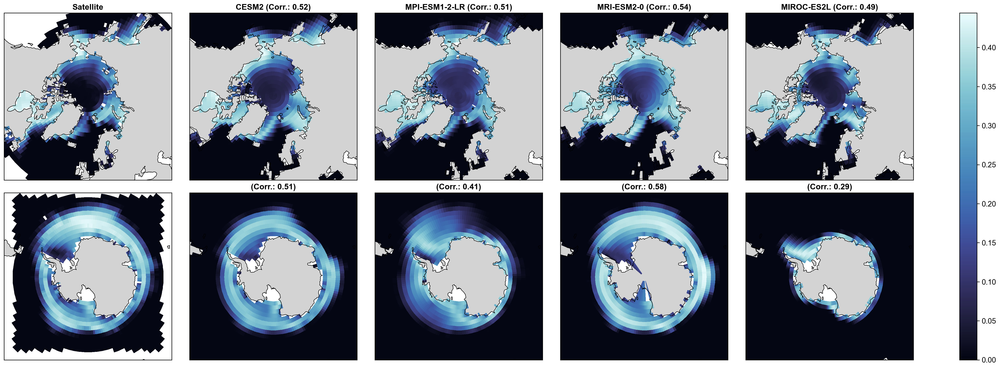

In [ ]:
def plot_sic_variability_satellite():
    fig = plt.figure(figsize=(5 * len(models) + 5, 9), dpi=200)
    gs = fig.add_gridspec(2, len(models) + 1)
    axs = np.empty((2, len(models) + 1), dtype=object)

    for i in range(len(models) + 1):
        axs[0, i] = fig.add_subplot(gs[0, i], projection=ccrs.NorthPolarStereo())
        axs[0, i].set_extent([0, 360, 50, 90], ccrs.PlateCarree())
        axs[1, i] = fig.add_subplot(gs[1, i], projection=ccrs.SouthPolarStereo())
        axs[1, i].set_extent([0, 360, -90, -50], ccrs.PlateCarree())
    
    stds = [ds["siconc"].sel(time=slice(1979, 2014)).std("time") for ds in [ds_sic]+dss]
    corrsn = [area_weighted_mean(xr.corr(ds["siconc"].where(ds.lat > 0), ds_sic["siconc"], "time")).compute().item() for ds in dss]
    corrss = [area_weighted_mean(xr.corr(ds["siconc"].where(ds.lat < 0), ds_sic["siconc"], "time")).compute().item() for ds in dss]
    vmax = max([ds.max().compute().item() for ds in stds])
    plot_field(axs.flat, stds*2, vmin=0, vmax=vmax,
                shade_land=True, plot_method="pcolormesh", cmap="cmo.ice",
                cbar_orientation="vertical", extend="neither")
    
    axs[0, 0].set_title("Satellite")
    for i, (model, corrn, corrs) in enumerate(zip(models, corrsn, corrss)):
        axs[0, i+1].set_title(f"{model} (Corr.: {corrn:.2f})")
        axs[1, i+1].set_title(f"(Corr.: {corrs:.2f})")

plot_sic_variability_satellite()

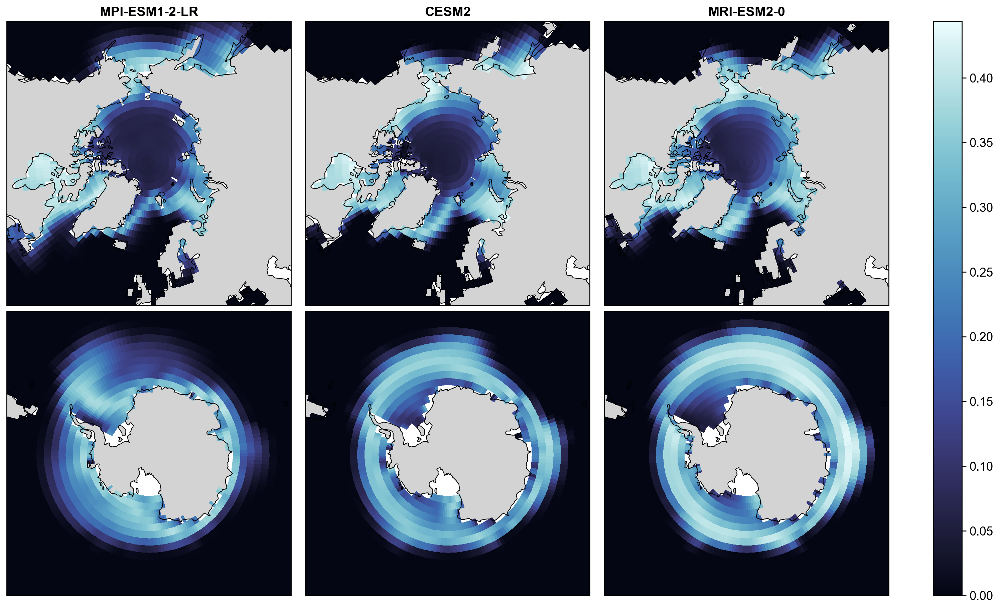

In [ ]:
def plot_sic_variability():
    fig = plt.figure(figsize=(5 * len(models), 9), dpi=200)
    gs = fig.add_gridspec(2, len(models))
    axs = np.empty((2, len(models)), dtype=object)

    for i, model in enumerate(models):
        axs[0, i] = fig.add_subplot(gs[0, i], projection=ccrs.NorthPolarStereo())
        axs[0, i].set_extent([0, 360, 50, 90], ccrs.PlateCarree())
        axs[0, i].set_title(model)
        axs[1, i] = fig.add_subplot(gs[1, i], projection=ccrs.SouthPolarStereo())
        axs[1, i].set_extent([0, 360, -90, -50], ccrs.PlateCarree())
    
    stds = [ds["siconc"].std("time") for ds in dss]
    vmax = max([ds.max().compute().item() for ds in stds])
    plot_field(axs.flat, stds*2, vmin=0, vmax=vmax, same_limits=False,
                shade_land=True, plot_method="pcolormesh", cmap="cmo.ice",
                cbar_orientation="vertical", extend="neither")

plot_sic_variability()

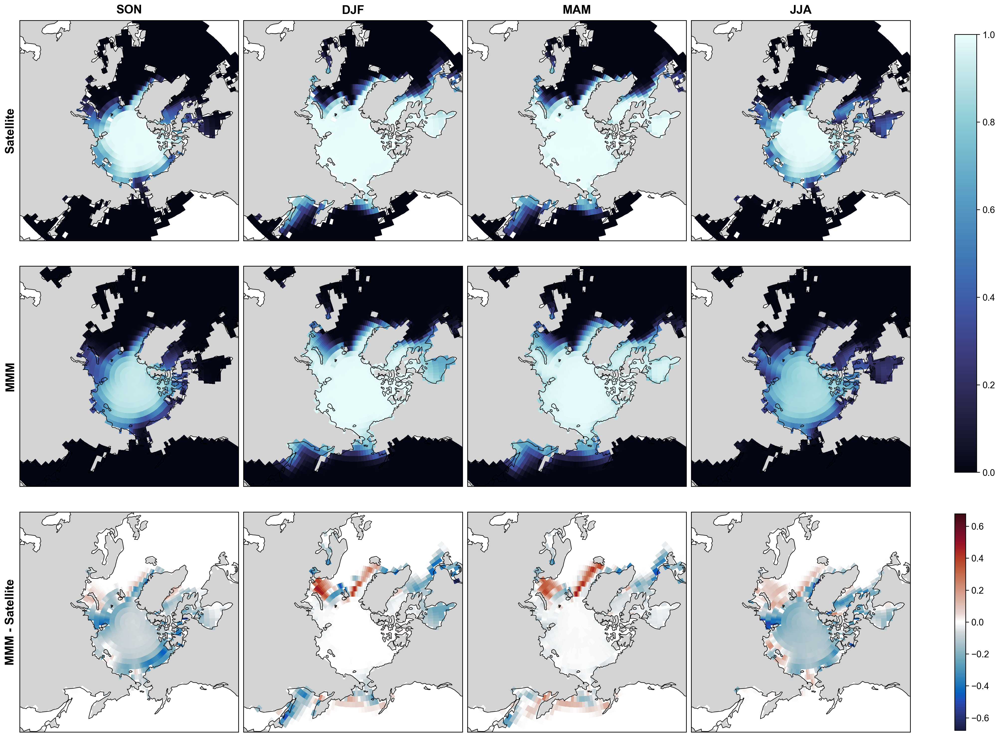

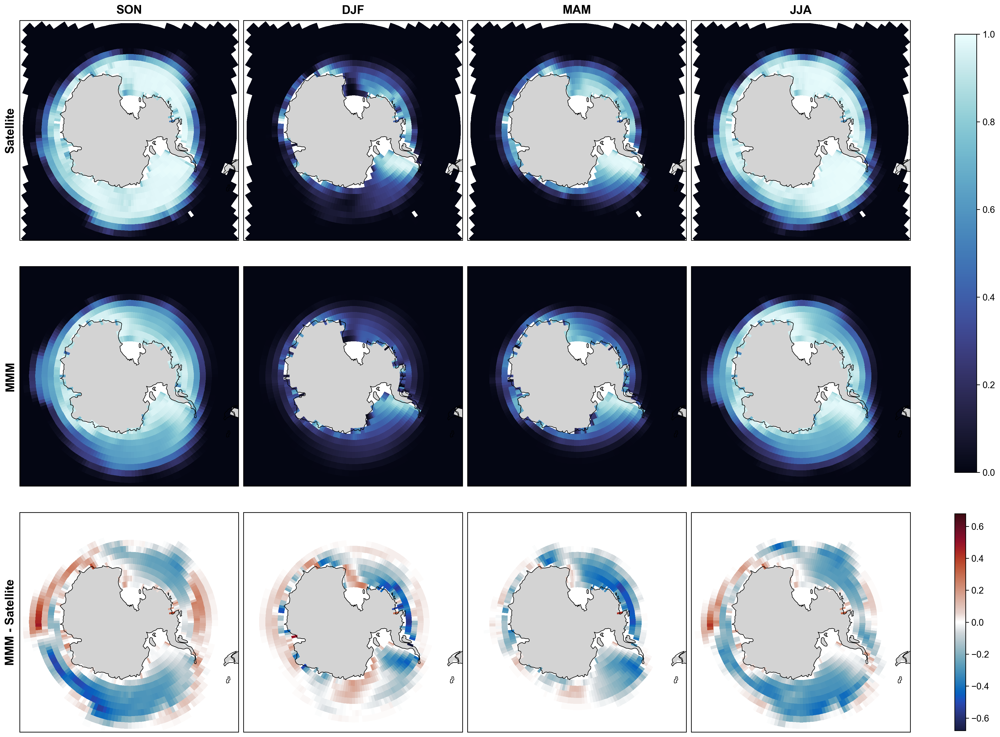

: 

In [ ]:
def plot_sic_climo_field(region, period=(1979, 2000)):
    fig, axs = subplots_cartopy(3, 4, projection="arctic" if region == "n" else "antarctic")
    
    season_order = [Season.SON, Season.DJF, Season.MAM, Season.JJA]

    climo_sat = add_season_coords(ds_sic["siconc"].sel(time=slice(*period))).groupby("season").mean()
    climo_mmm = add_season_coords(mmm["siconc"].sel(time=slice(*period))).groupby("season").mean()

    plot_field(axs[:2, :].flat,
               [climo_sat.sel(season=s) for s in season_order] + [climo_mmm.sel(season=s) for s in season_order],
               vmin=0, vmax=1, same_limits=False,
                shade_land=True, plot_method="pcolormesh", cmap="cmo.ice",
                cbar_orientation="vertical", extend="neither", cbar_shrink=0.9)

    plot_field(axs[2, :], [(climo_mmm - climo_sat).sel(season=s) for s in season_order],
                shade_land=True, plot_method="pcolormesh", cmap="balancew",
                cbar_orientation="vertical", extend="neither", cbar_shrink=0.9, cbar_aspect=10)
    
    add_subplot_headers(["Satellite", "MMM", "MMM - Satellite"], ["SON", "DJF", "MAM", "JJA"])

plot_sic_climo_field("n")
plot_sic_climo_field("s")

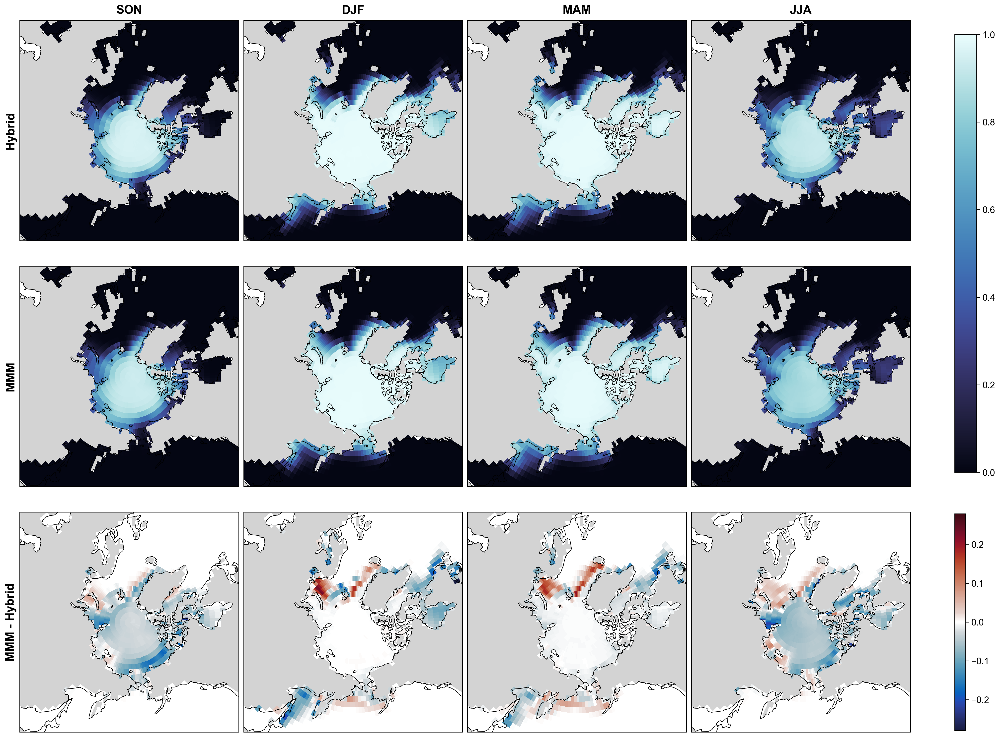

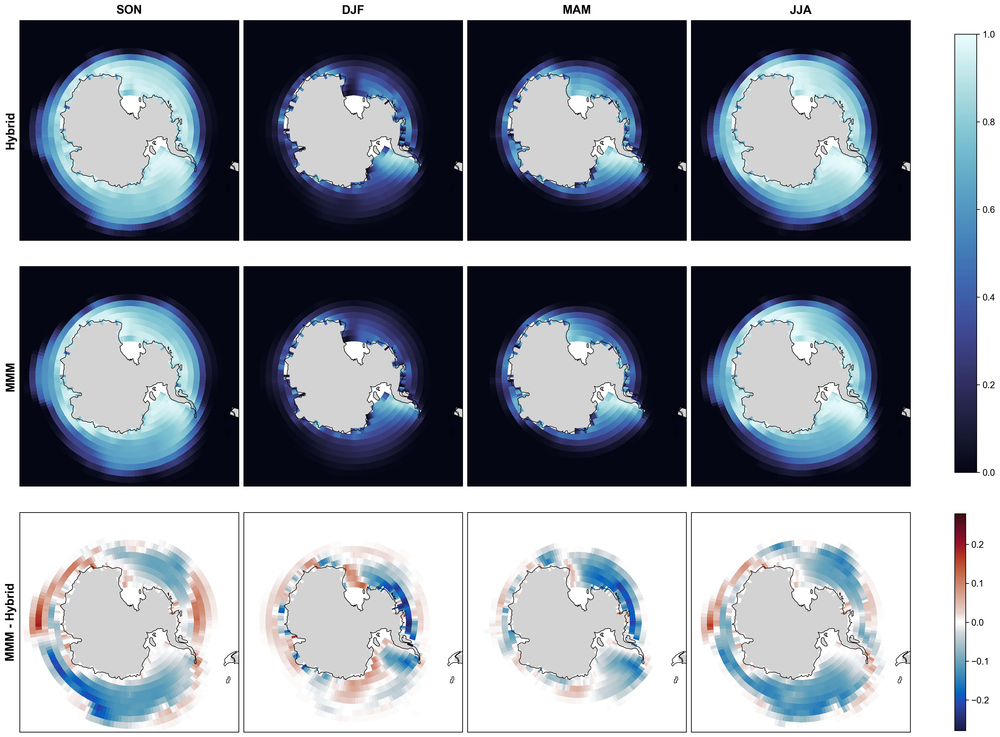

In [ ]:
def plot_hybrid_sic_climo_field(region):
    fig, axs = subplots_cartopy(3, 4, projection="arctic" if region == "n" else "antarctic")
    
    hybrid = xr.concat([
        mmm["siconc"].sel(time=slice(1961, ds_sic.time[0]-0.5/12)),
        ds_sic["siconc"].sel(time=slice(None, 1991))
    ], dim="time")
    period = (1961, 1991)

    season_order = [Season.SON, Season.DJF, Season.MAM, Season.JJA]

    climo_sat = add_season_coords(hybrid.sel(time=slice(*period))).groupby("season").mean()
    climo_mmm = add_season_coords(mmm["siconc"].sel(time=slice(*period))).groupby("season").mean()

    plot_field(axs[:2, :].flat,
               [climo_sat.sel(season=s) for s in season_order] + [climo_mmm.sel(season=s) for s in season_order],
               vmin=0, vmax=1, same_limits=False,
                shade_land=True, plot_method="pcolormesh", cmap="cmo.ice",
                cbar_orientation="vertical", extend="neither", cbar_shrink=0.9)

    plot_field(axs[2, :], [(climo_mmm - climo_sat).sel(season=s) for s in season_order],
                shade_land=True, plot_method="pcolormesh", cmap="balancew",
                cbar_orientation="vertical", extend="neither", cbar_shrink=0.9, cbar_aspect=10)
    
    add_subplot_headers(["Hybrid", "MMM", "MMM - Hybrid"], ["SON", "DJF", "MAM", "JJA"])

plot_hybrid_sic_climo_field("n")
plot_hybrid_sic_climo_field("s")

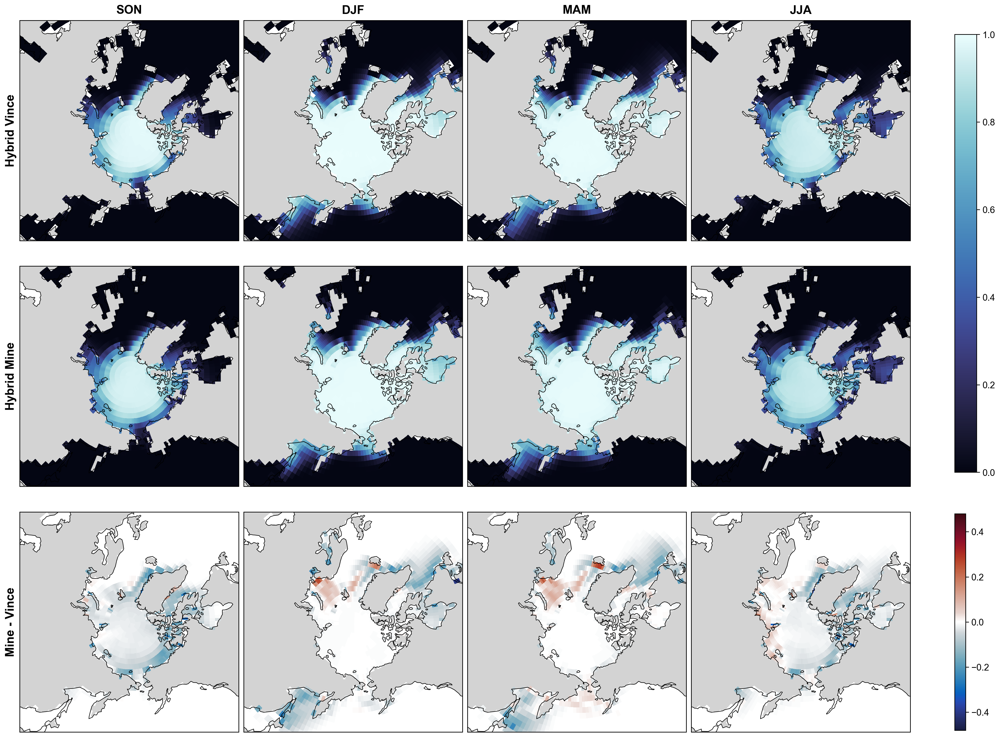

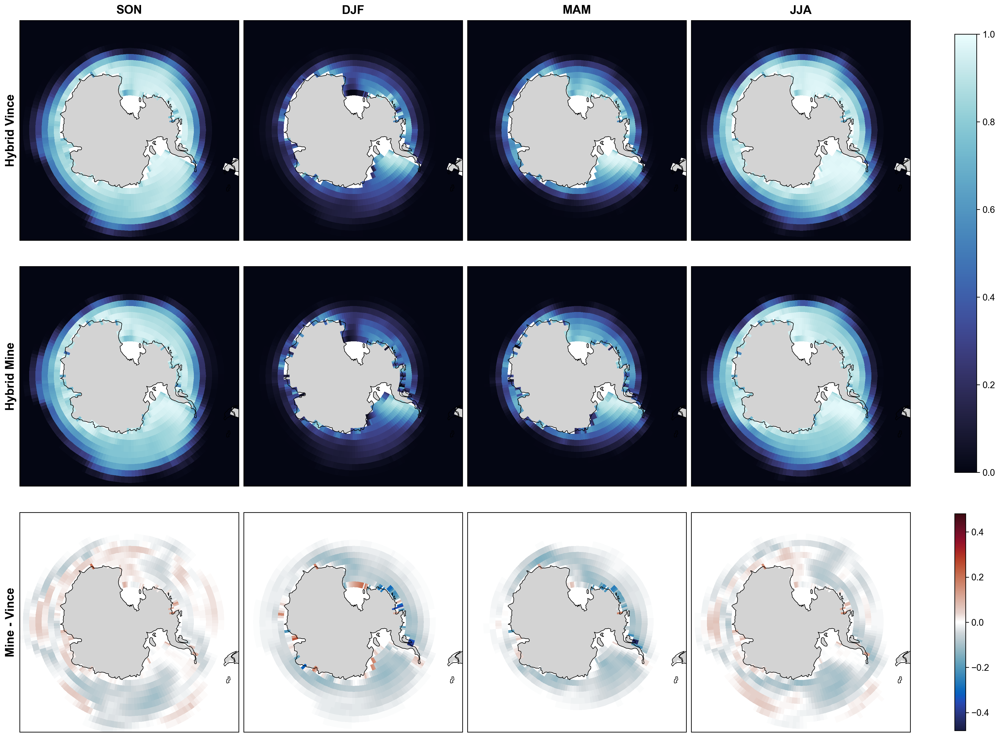

In [ ]:
from lmrecon.grid import Regridder
from lmrecon.io import open_mfdataset
from lmrecon.util import get_base_path


def plot_hybrid_sic_climo_field(region):
    fig, axs = subplots_cartopy(3, 4, projection="arctic" if region == "n" else "antarctic")
    
    ds = xr.open_mfdataset(str(get_base_path() / "datasets/climo_vince/*_siconc_1961_1990.nc"), combine="nested", concat_dim="ens").mean("ens")
    ds = Regridder().regrid(ds)
    ds = average_seasonally(ds) / 100

    hybrid = xr.concat([
        ds["siconc"].sel(time=slice(1961, ds_sic.time[0]-0.5/12)),
        ds_sic["siconc"].sel(time=slice(None, 1991))
    ], dim="time")
    hybrid2 = xr.concat([
        mmm["siconc"].sel(time=slice(1961, ds_sic.time[0]-0.5/12)),
        ds_sic["siconc"].sel(time=slice(None, 1991))
    ], dim="time")
    period = (1961, 1991)

    season_order = [Season.SON, Season.DJF, Season.MAM, Season.JJA]

    climo_sat = add_season_coords(hybrid.sel(time=slice(*period))).groupby("season").mean()
    climo_mmm = add_season_coords(hybrid2.sel(time=slice(*period))).groupby("season").mean()

    plot_field(axs[:2, :].flat,
               [climo_sat.sel(season=s) for s in season_order] + [climo_mmm.sel(season=s) for s in season_order],
               vmin=0, vmax=1, same_limits=False,
                shade_land=True, plot_method="pcolormesh", cmap="cmo.ice",
                cbar_orientation="vertical", extend="neither", cbar_shrink=0.9)

    plot_field(axs[2, :], [(climo_mmm - climo_sat).sel(season=s) for s in season_order],
                shade_land=True, plot_method="pcolormesh", cmap="balancew",
                cbar_orientation="vertical", extend="neither", cbar_shrink=0.9, cbar_aspect=10)
    
    add_subplot_headers(["Hybrid Vince", "Hybrid Mine", "Mine - Vince"], ["SON", "DJF", "MAM", "JJA"])

plot_hybrid_sic_climo_field("n")
plot_hybrid_sic_climo_field("s")

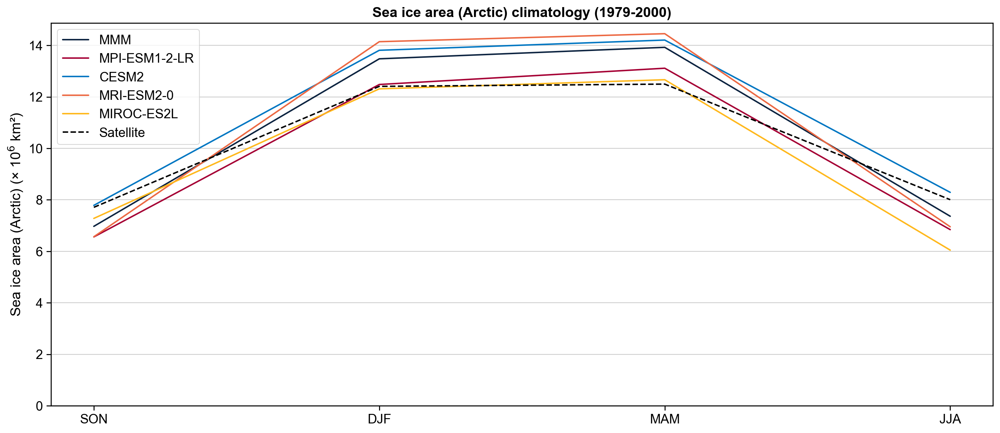

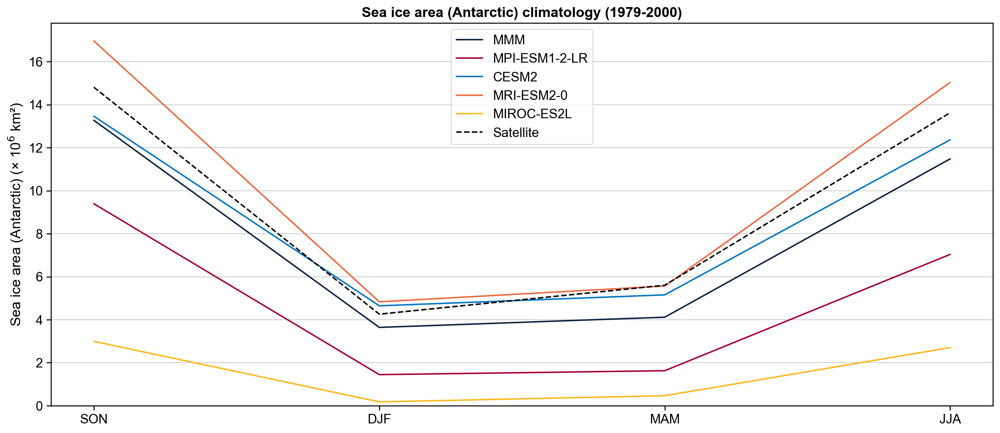

In [ ]:
def plot_sic_climatology(field, period=(1979, 2000)):
    fig, ax = plt.subplots()

    season_order = [Season.SON, Season.DJF, Season.MAM, Season.JJA]

    for model, ds in zip(["MMM"] + models, [mmm] + dss):
        climo = add_season_coords(ds[field].sel(time=slice(*period))).groupby("season").mean() / 1e6
        climo = climo.sel(season=season_order)
        ax.plot(np.arange(4), climo, label=model)

    climo = add_season_coords(ds_sic[field].sel(time=slice(*period))).groupby("season").mean() / 1e6
    climo = climo.sel(season=season_order)
    ax.plot(np.arange(4), climo, label="Satellite", ls="--", color="black")

    ax.legend()
    ax.set_xticks(np.arange(4), ["SON", "DJF", "MAM", "JJA"])
    ax.set_yticks(np.arange(0, ax.get_ylim()[1], 2))
    ax.set_ylabel(f"{get_field_label(field)} (× 10$^6$ km²)")
    ax.set_title(f"{get_field_label(field)} climatology ({period[0]}-{period[1]})")
    use_zero_ylim(ax)

    ax.grid(which="major", axis="y")

plot_sic_climatology("siarean")
# plot_sic_climatology("siextentn")
plot_sic_climatology("siareas")
# plot_sic_climatology("siextents")

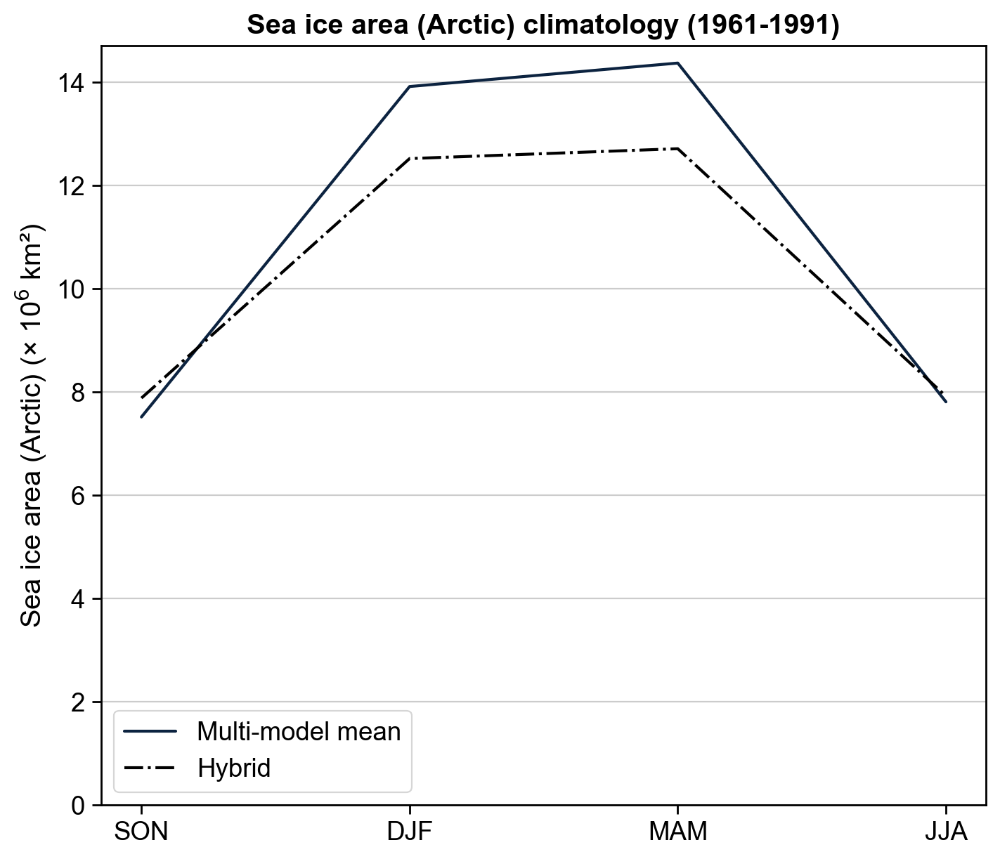

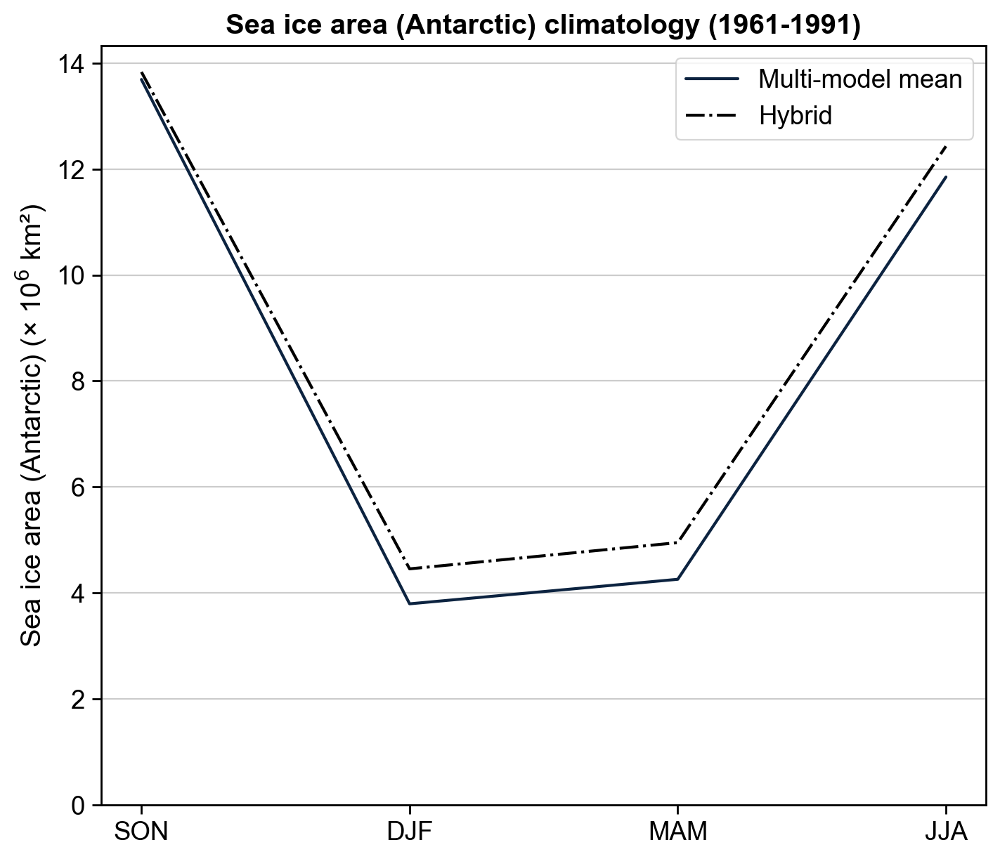

In [ ]:
def plot_hybrid_sic_climatology(field):
    fig, ax = plt.subplots(figsize=(7, 6))

    hybrid = calculate_sistatistics(hybrid_vince)
    period = (1961, 1991)

    season_order = [Season.SON, Season.DJF, Season.MAM, Season.JJA]

    for model, ds in zip(["Multi-model mean"], [mmm]):
    # for model, ds in zip(["MMM"] + models, [mmm] + dss):
        climo = add_season_coords(ds[field].sel(time=slice(*period))).groupby("season").mean() / 1e6
        climo = climo.sel(season=season_order)
        ax.plot(np.arange(4), climo, label=model)

    climo = add_season_coords(hybrid[field].sel(time=slice(*period))).groupby("season").mean() / 1e6
    climo = climo.sel(season=season_order)
    ax.plot(np.arange(4), climo, label="Hybrid", ls="-.", color="black")

    ax.legend()
    ax.set_xticks(np.arange(4), ["SON", "DJF", "MAM", "JJA"])
    ax.set_yticks(np.arange(0, ax.get_ylim()[1], 2))
    ax.set_ylabel(f"{get_field_label(field)} (× 10$^6$ km²)")
    ax.set_title(f"{get_field_label(field)} climatology ({period[0]}-{period[1]})")
    use_zero_ylim(ax)

    ax.grid(which="major", axis="y")

plot_hybrid_sic_climatology("siarean")
plot_hybrid_sic_climatology("siareas")

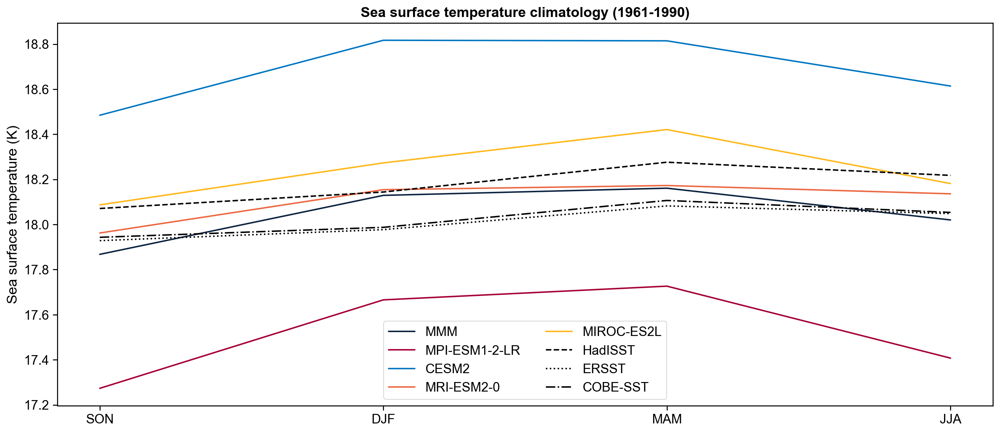

In [ ]:
def plot_sst_climatology(period=(1961, 1991)):
    fig, ax = plt.subplots()

    season_order = [Season.SON, Season.DJF, Season.MAM, Season.JJA]

    for model, ds in zip(["MMM"] + models, [mmm] + dss):
        climo = add_season_coords(area_weighted_mean(ds["tos"]).sel(time=slice(*period))).groupby("season").mean() - 273.15
        climo = climo.sel(season=season_order)
        ax.plot(np.arange(4), climo, label=model)

    climo = add_season_coords(area_weighted_mean(ds_hadisst["tos"]).sel(time=slice(*period))).groupby("season").mean()
    climo = climo.sel(season=season_order)
    ax.plot(np.arange(4), climo, label="HadISST", ls="--", color="black")

    climo = add_season_coords(area_weighted_mean(ds_ersst["tos"]).sel(time=slice(*period))).groupby("season").mean()
    climo = climo.sel(season=season_order)
    ax.plot(np.arange(4), climo, label="ERSST", ls=":", color="black")

    climo = add_season_coords(area_weighted_mean(ds_cobesst["tos"]).sel(time=slice(*period))).groupby("season").mean()
    climo = climo.sel(season=season_order)
    ax.plot(np.arange(4), climo, label="COBE-SST", ls="-.", color="black")

    ax.legend(ncol=2)
    ax.set_xticks(np.arange(4), ["SON", "DJF", "MAM", "JJA"])
    ax.set_ylabel(f"{get_field_label("tos", True)}")
    ax.set_title(f"{get_field_label("tos")} climatology ({period[0]}-{period[1]-1})")

plot_sst_climatology()

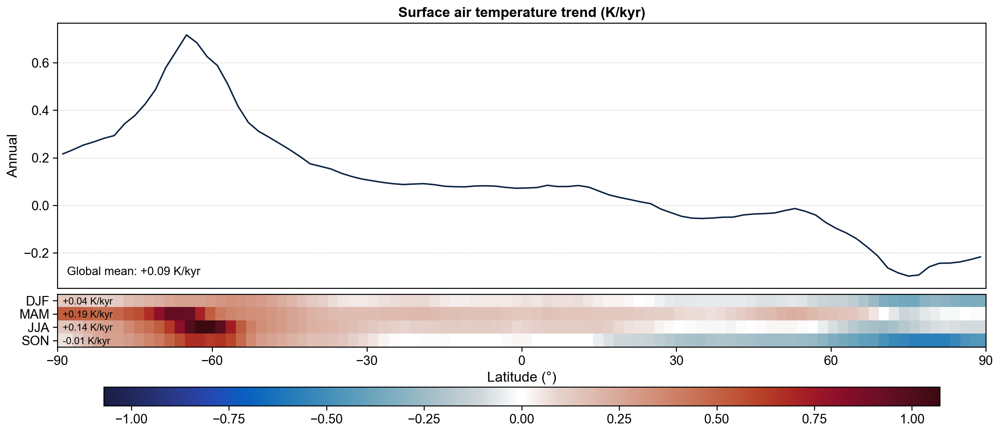

In [ ]:
def plot_seasonal_latitudinal_trend(field, unit, factor=1):
    fig, axs = plt.subplots(2, 1, figsize=(14, 6), height_ratios=[5, 1], sharex=True)

    # ds = mmm_anom
    ds = dss_anom[2]

    x = ds[field].mean("lon").sel(time=slice(850, 1850)) * factor

    trend = use_tuple_time_coords(x).groupby("season").apply(
        lambda y: y.polyfit("year", deg=1)["polyfit_coefficients"].sel(degree=1) * 1e3
    ).compute()  # unit/kyr
    trend_ann = x.polyfit("time", deg=1)["polyfit_coefficients"].sel(degree=1).compute() * 1e3  # unit/kyr

    x = area_weighted_mean(ds[field]).sel(time=slice(850, 1850)) * factor

    trend_globalmean = use_tuple_time_coords(x).groupby("season").apply(
        lambda y: y.polyfit("year", deg=1)["polyfit_coefficients"].sel(degree=1) * 1e3
    ).compute()  # unit/kyr
    trend_globalmean_ann = x.polyfit("time", deg=1)["polyfit_coefficients"].sel(degree=1).compute() * 1e3

    ## Annual
    ci = 0.95
    axs[0].plot(trend_ann.lat, trend_ann)
    axs[0].set_ylabel("Annual")
    axs[0].set_title(f"{get_field_label(field, add_units=False)} trend ({unit}/kyr)")
    axs[0].grid(axis='y', which='major', linewidth=1.0, linestyle=":")
    axs[0].tick_params(axis='x', which='major', top=False, bottom=False, direction='in')
    axs[0].text(0.01, 0.04, f"Global mean: {trend_globalmean_ann:+.2f} {unit}/kyr",
            transform=axs[0].transAxes, verticalalignment='bottom', horizontalalignment='left',
            fontsize="smaller", bbox=dict(facecolor="white", pad=0.1, alpha=0.6))

    ## Seasonal
    vmax = np.abs(trend).max().compute()
    values = trend.transpose("season", "lat").values
    # Repeat pole pixel to fill gap
    values = np.hstack([values[:, [0]], values, values[:, [-1]]])
    axs[1].imshow(values,
                  extent=[trend.lat[0] - 2, trend.lat[-1] + 2, 0, 4], aspect=3,
                  cmap="balancew", vmin=-vmax, vmax=vmax)
    plt.colorbar(axs[1].images[0], ax=axs[1],
                        orientation='horizontal', fraction=0.35, aspect=45)
    axs[1].set_xlabel("Latitude (°)")
    axs[1].set_yticks([0.5, 1.5, 2.5, 3.5], reversed(Season.to_str_list(trend.season.values)))
    axs[1].set_aspect("auto")
    axs[1].set_xticks(np.arange(-90, 91, 30))
    axs[1].set_xlim([-90, 90])

    for y, season in zip(reversed([0.5, 1.5, 2.5, 3.5]), trend.season.values):
        axs[1].text(-89, y, f"{trend_globalmean.sel(season=season).item():+.2f} {unit}/kyr",
                    fontsize="x-small", #bbox=dict(facecolor="white", pad=0.1, alpha=0.6),
                    verticalalignment="center_baseline")

plot_seasonal_latitudinal_trend("tas", "K")
# plot_seasonal_latitudinal_trend("tos", "K")
# plot_seasonal_latitudinal_trend("rlut", "(W/m²)")
# plot_seasonal_latitudinal_trend("rsdt", "(W/m²)",)
# plot_seasonal_latitudinal_trend("eei", "(W/m²)",)
# # plot_seasonal_latitudinal_trend("eei_inferred", "(W/m²)",)
# plot_seasonal_latitudinal_trend("ohc300", "×10$^6$ (J/m²)", 1e-6)
# plot_seasonal_latitudinal_trend("siconc", "%", 100)

In [ ]:
models

['MPI-ESM1-2-LR', 'CESM2', 'MRI-ESM2-0']

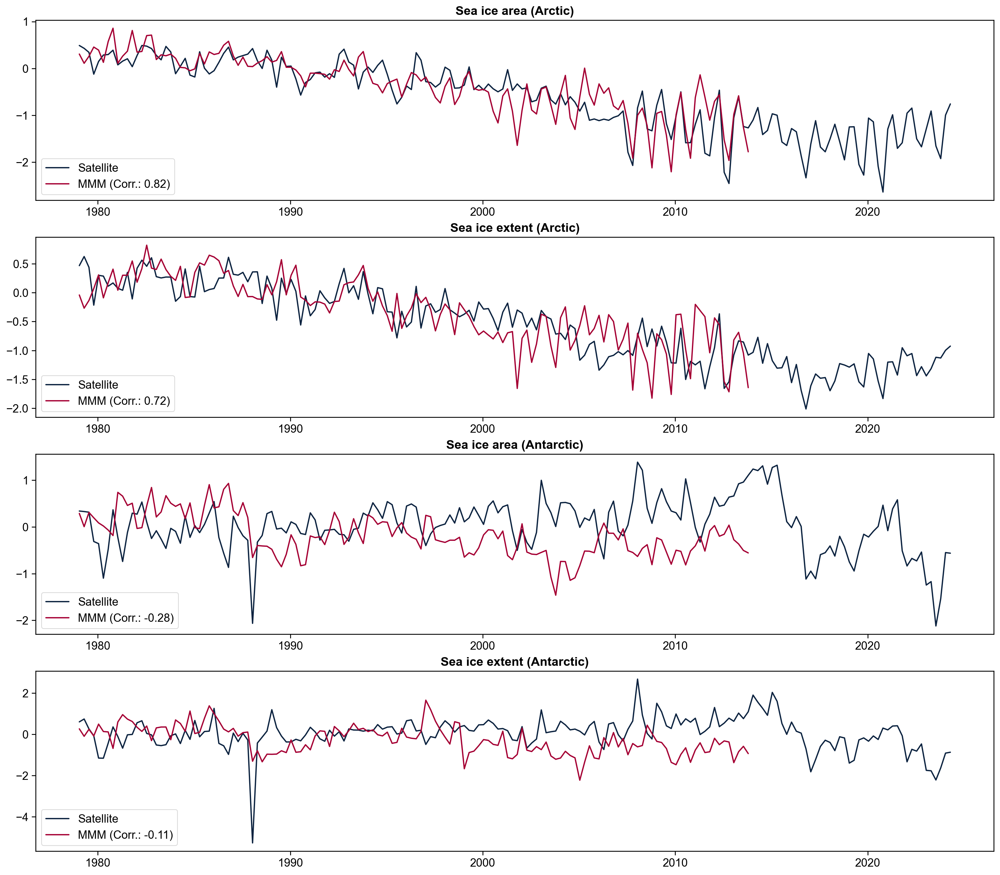

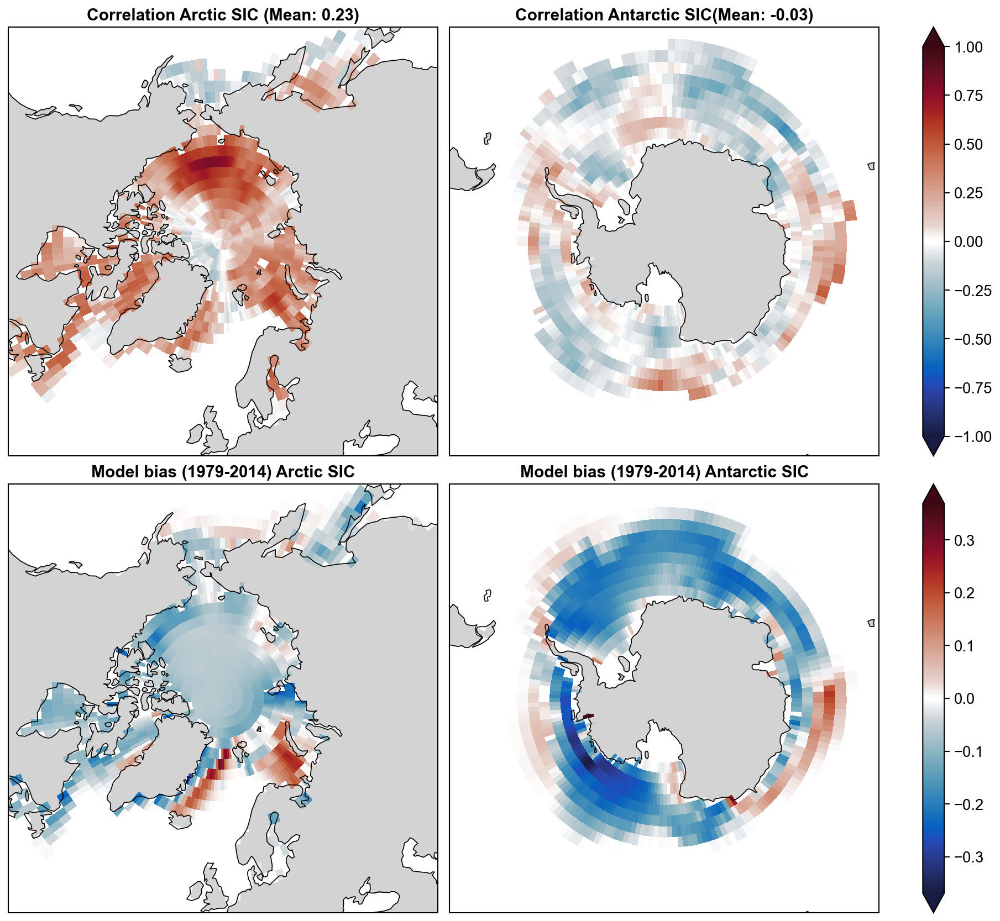

In [ ]:
def compare_mmm_sic():
    ds_siindex = anomalize(ds_sic, (1979, 2001))

    mmm_siindex = anomalize(calculate_sistatistics(mmm.sel(time=slice(1979, 2014))), (1979, 2001))

    fig, axs = plt.subplots(4, 1, figsize=(16, 14))
    for field, ax in zip(["siarean", "siextentn", "siareas", "siextents"], axs):
        ax.plot(ds_siindex.time, ds_siindex[field] / 1e6, label="Satellite")
        corr = xr.corr(ds_siindex[field], mmm_siindex[field]).compute().item()
        ax.plot(mmm_siindex.time, mmm_siindex[field] / 1e6, label=f"MMM (Corr.: {corr:.2f})")
        ax.set_title(get_field_label(field))

        # for ds, model in zip(dss, models):
        #     siarean = anomalize(calculate_sistatistic(ds.sel(time=slice(1979, 2014)), field), (1979, 2001))
        #     ax.plot(siarean.time, siarean / 1e6, label=f"{model}", ls="--", zorder=-1)

        ax.legend(loc="lower left")


    fig = plt.figure(figsize=(12, 11), dpi=150)
    gs = fig.add_gridspec(2, 2)
    axs = np.empty((2, 2), dtype=object)

    axs[0, 0] = fig.add_subplot(gs[0, 0], projection=ccrs.NorthPolarStereo())
    axs[0, 1] = fig.add_subplot(gs[0, 1], projection=ccrs.SouthPolarStereo())
    axs[1, 0] = fig.add_subplot(gs[1, 0], projection=ccrs.NorthPolarStereo())
    axs[1, 1] = fig.add_subplot(gs[1, 1], projection=ccrs.SouthPolarStereo())

    for ax in axs[:, 0]:
        ax.set_extent([0, 360, 50, 90], ccrs.PlateCarree())
    for ax in axs[:, 1]:
        ax.set_extent([0, 360, -90, -50], ccrs.PlateCarree())

    corr = xr.corr(anomalize(ds_sic["siconc"], (1979, 2001)), anomalize(mmm["siconc"], (1979, 2001)), dim="time")
    plot_field(axs[0, :], [corr, corr], vmin=-1, vmax=1, plot_method="pcolormesh", cmap="balancew",
        shade_land=True, cbar_orientation="vertical")
    corr_mean = area_weighted_mean(corr.where(corr.lat > 0)).compute().item()
    axs[0, 0].set_title(f"Correlation Arctic SIC (Mean: {corr_mean:.2f})")
    corr_mean = area_weighted_mean(corr.where(corr.lat < 0)).compute().item()
    axs[0, 1].set_title(f"Correlation Antarctic SIC(Mean: {corr_mean:.2f})")

    plot_field(axs[1, :], [
            mmm["siconc"].sel(time=slice(1979, 2014)).mean("time") - ds_sic["siconc"].sel(time=slice(1979, 2014)).mean("time")
        ] * 2, same_limits=True, plot_method="pcolormesh", cmap="balancew",
        shade_land=True, cbar_orientation="vertical")
    axs[1, 0].set_title("Model bias (1979-2014) Arctic SIC")
    axs[1, 1].set_title("Model bias (1979-2014) Antarctic SIC")

compare_mmm_sic()

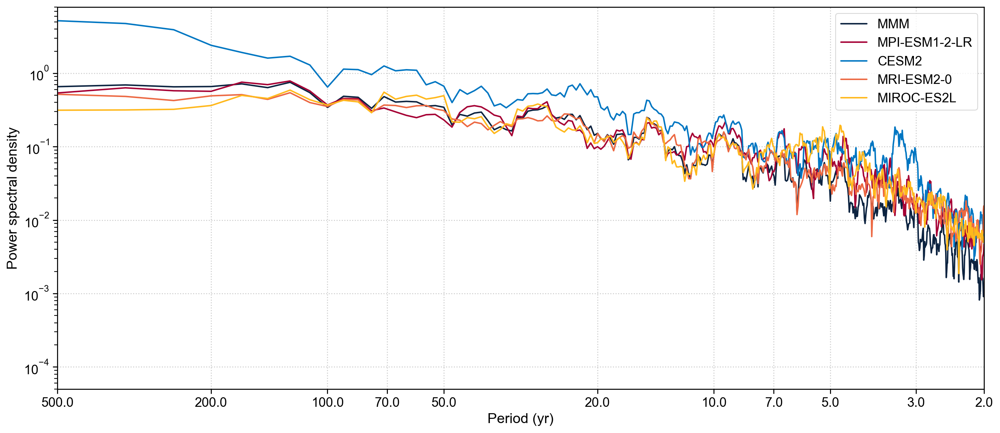

In [ ]:
def plot_spectrum(field, min_f=500, max_f=2):
    fig, ax = plt.subplots(figsize=(14, 6))

    for model, ds in zip(["MMM"] + models, [mmm_anom] + dss_anom):
        # Missing samples around 1850 mess up MTM
        ds = area_weighted_mean(ds[field]).sel(time=slice(850, 1850))
        # ds = Nino34Index().compute_index(ds["tos"].sel(time=slice(850, 1850)))
        psd = compute_spectrum_multitaper(ds, detrend=False)
        psd = psd.sel(f=slice(None, 1/max_f))
        ax.plot(psd.f, psd, label=model)
    
    ax.set_ylabel(f"Power spectral density")

    ax.set_xlabel("Period (yr)")
    ax.set_yscale("log")
    ax.set_xscale("log")
    ax.legend()

    format_plot(major_grid=True)
    ticks = np.array([500, 200, 100, 70, 50, 20, 10, 7, 5, 3, 2, 1, 1 / 2])
    ax.set_xticks(1/ticks, ticks)
    ax.set_xlim(1/min_f, 1/max_f)
    # ax.set_ylim(0.5e-4, 8)
    ax.tick_params(axis="y", which="minor", left=True)

plot_spectrum("tas")

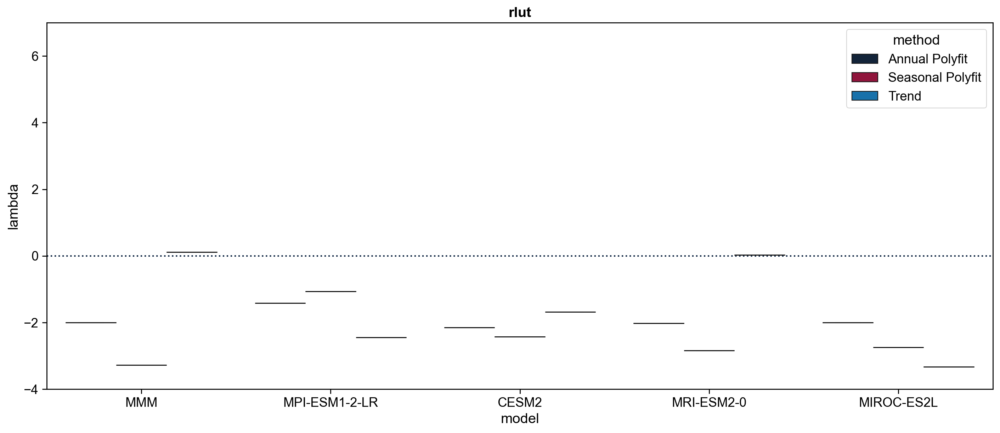

In [ ]:
import sklearn


def print_lambda(type):
    def get_polyfit(tas, eei, annual):
        if annual:
            tas = average_annually(tas)
            eei = average_annually(eei)
        tas = tas.values
        eei = eei.values
        # return np.polyfit(tas, eei, 1)[0]
        reg = sklearn.linear_model.RANSACRegressor(random_state=42)
        reg.fit(tas[:, np.newaxis], eei[:, np.newaxis])
        return np.squeeze(reg.estimator_.coef_)

    def get_trend(tas, eei):
        trend_tas = tas.polyfit("time", 1)["polyfit_coefficients"].values[0]
        trend_eei = eei.polyfit("time", 1)["polyfit_coefficients"].values[0]
        return trend_eei / trend_tas

    lambda_polyfit_annual = []
    lambda_polyfit_seasonal = []
    lambda_trend = []

    for ds in [mmm_anom] + list(dss_anom):
        ds = area_weighted_mean(ds[["tas", "eei", "rsut", "rlut"]].sel(time=slice(850, 1850)))
        tas = ds["tas"]
        match type:
            case "eei": eei = ds["eei"]
            case "eei_inferred": eei = - (ds["rsut"] + ds["rlut"])
            case "rsut": eei = -ds["rsut"]
            case "rlut": eei = -ds["rlut"]
        
        lambda_polyfit_annual.append(get_polyfit(tas, eei, True))
        lambda_polyfit_seasonal.append(get_polyfit(tas, eei, False))
        lambda_trend.append(get_trend(tas, eei))
    
    da = xr.DataArray(np.array([np.array(lambda_polyfit_annual), 
                     np.array(lambda_polyfit_seasonal), 
                     np.array(lambda_trend)]).squeeze(), dims=["method", "model"])
    da = da.assign_coords(model=["MMM"] + models, method=["Annual Polyfit", "Seasonal Polyfit", "Trend"])
    df = da.to_dataframe(name="lambda").reset_index()

    import seaborn as sns
    fig, ax = plt.subplots()
    sns.boxplot(data=df, x="model", y="lambda", hue="method", orient="v", ax=ax)
    if type == "rlut":
        use_zero_ylim(ax, lower=False)
    ax.set_title(type)
    ax.set_ylim(-4, 7)
    ax.axhline(0, ls=":")

print_lambda("rlut")

In [ ]:
from cycler import cycler

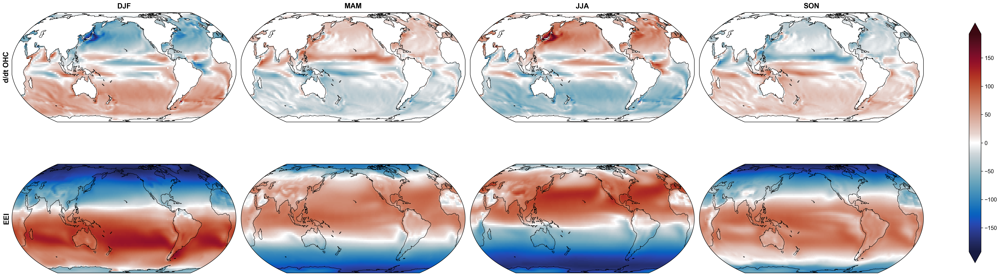

In [ ]:
from lmrecon.constants import OCEAN_FRACTION


fig, axs = subplots_cartopy(2, 4, cbar_vertical=True)
x = dss[1]
x["ddtohc300"] = x["ohc300"].differentiate("time") / SECONDS_PER_YEAR * OCEAN_FRACTION
_, x = anomalize(x, return_climatology=True)
plot_field(axs, [
    x["ddtohc300"].sel(season=Season.DJF),
    x["ddtohc300"].sel(season=Season.MAM),
    x["ddtohc300"].sel(season=Season.JJA),
    x["ddtohc300"].sel(season=Season.SON),
    x["eei"].sel(season=Season.DJF),
    x["eei"].sel(season=Season.MAM),
    x["eei"].sel(season=Season.JJA),
    x["eei"].sel(season=Season.SON),
], cbar_orientation="vertical", cbar_kwargs={"shrink": 0.8})
add_subplot_headers(["d/dt OHC", "EEI"], ["DJF", "MAM", "JJA", "SON"])

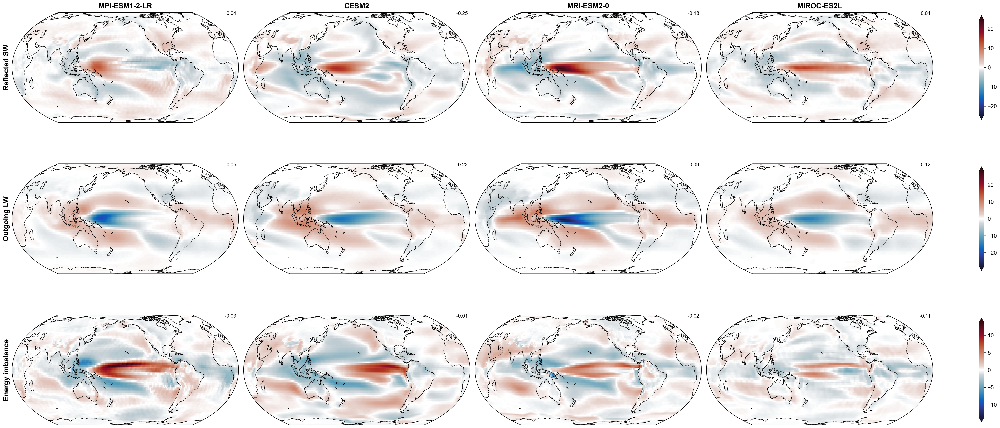

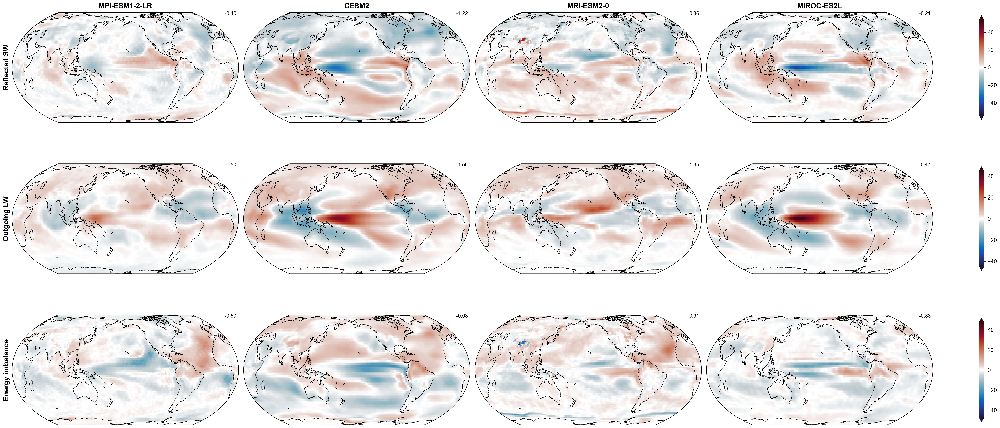

In [ ]:
def plot_toa_regression(index):
    fig, axs = subplots_cartopy(3, len(models), cbar_vertical=True)

    for i, field in enumerate(["rsut", "rlut", "eei"]):
        regressions = [
            regress_field(ds[field], index.compute_index(ds["tos"]))
            for ds in dss_anom
        ]
        plot_field(axs[i, :], regressions, cbar_orientation="vertical", cbar_kwargs=dict(shrink=0.7))
        for j, reg in enumerate(regressions):
            ax = axs[i, j]
            ax.text(
                0.99, 1.01, f"{area_weighted_mean(reg):.2f}",
                transform=ax.transAxes,
                ha="right", va="top",
                fontsize="small",
            )
    
    add_subplot_headers([get_field_label(field) for field in ["rsut", "rlut", "eei"]], models)

plot_toa_regression(Nino34Index())
plot_toa_regression(AMOIndex())
# plot_toa_regression(PDOIndex.load())

<xarray.DataArray 'time' (time: 19)> Size: 152B
[19 values with dtype=object]
Coordinates:
  * time     (time) object 152B MultiIndex
  * year     (time) int64 152B 1028 1108 1171 1191 1230 ... 1809 1815 1835 1883
  * season   (time) object 152B Season.DJF Season.DJF ... Season.DJF Season.JJA
tas -0.5912594208811853 0.051356925090956275
ohc300_total -60.309555700069 3.4309130838049824
rsut -0.4516213811608532 7.065685092007704
eei -3.6822455633391327 0.6865541731960321


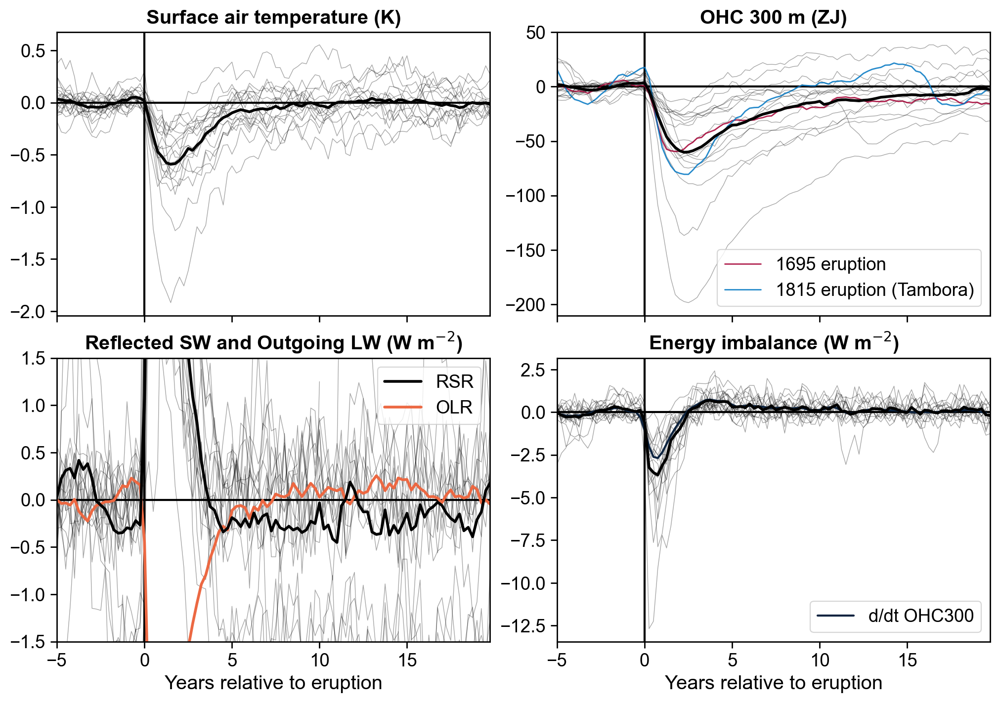

In [ ]:
def plot_volcano_composite(vssi_min=7.5, lat_max=30, n_before=20, n_after=80, n_climo=20):
    eruptions = use_tuple_time_coords(ds_evolv2k.sel(time=ds_evolv2k["vssi"] >= vssi_min), True).drop_duplicates(dim="time")
    eruptions = eruptions.sel(time=((eruptions.lat >= -lat_max) & (eruptions.lat < lat_max)))

    recon = area_weighted_mean(mmm_anom[["ohc300", "tas", "rsut", "rlut", "eei"]])
    recon["ddtohc300"] = recon["ohc300"].differentiate("time") / SECONDS_PER_YEAR * OCEAN_FRACTION
    recon["ohc300_total"] = convert_ohc_per_ocean_area_to_total_ohc(recon["ohc300"])
    recon = use_tuple_time_coords(recon)

    eruption_times, eruptions = xr.align(recon.time, eruptions, join="inner")
    recon_sel = []
    for i, (eruption_time, eruption_time_next) in enumerate(list(pairwise(eruption_times)) + [(eruption_times[-1], None)]):
        idx = recon.get_index("time").get_loc(eruption_time.item())
        # Trim if there is another eruption within the window
        recon_eruption = use_decimal_year_time_coords(
            recon.isel(time=slice(idx-n_before, idx+n_after)).sel(time=slice(None, eruption_time_next))
        )
        climo = recon.isel(time=slice(idx-n_climo, idx)).groupby("season").mean("time").compute()
        recon_sel.append(
            (add_season_coords(recon_eruption).groupby("season") - climo)
            .assign_coords(eruption=i, time=np.arange(-n_before, -n_before + len(recon_eruption.time)))
        )
    recon_sel = xr.concat(recon_sel, dim="eruption")
    print(eruption_times)

    fig, axs = plt.subplots(2, 2, figsize=(10, 7), sharex=True)

    for i, (field, ax) in enumerate(zip(["tas", "ohc300_total", "rsut", "eei"], axs.flat)):
        scaling = get_field_scaling(field)

        ax.axvline(0, c="black", zorder=-3)
        # ax.axvline(1, c="black")
        # ax.axvline(2, c="black")
        # ax.axvline(3, c="black")
        # ax.axvline(4, c="black")
        ax.axhline(0, c="black", zorder=-3)

        for eruption in recon_sel.eruption:
            c = "black"
            lw = 0.5
            alpha = 0.35
            label = None
            legend = False
            if field == "ohc300_total":
                if eruption_times.isel(time=eruption).item() == (1695, Season.DJF):
                    c = "C1"
                    lw = 1
                    alpha = 0.85
                    label = "1695 eruption"
                    legend = True
                elif eruption_times.isel(time=eruption).item() == (1815, Season.MAM):
                    c = "C2"
                    lw = 1
                    alpha = 0.85
                    label = "1815 eruption (Tambora)"
                    legend = True
            ax.plot(recon_sel.time / 4, recon_sel[field].sel(eruption=eruption) / scaling,
                    lw=lw, c=c, alpha=alpha, label=label)
            if legend:
                ax.legend()
        
        if field == "eei":
            ax.plot(recon_sel.time / 4, recon_sel["ddtohc300"].mean("eruption").compute().rolling(time=3, center=True).mean(),
                    c="C0", label="d/dt OHC300")
            ax.legend()

        print(field, (recon_sel[field].mean("eruption") / scaling).min().compute().item(),
                (recon_sel[field].mean("eruption") / scaling).max().compute().item())
        if field == "rsut":
            ax.plot(recon_sel.time / 4, recon_sel["rsut"].mean("eruption") / scaling,
                    c="black", lw=2, label="RSR", zorder=5)
            ax.plot(recon_sel.time / 4, recon_sel["rlut"].mean("eruption") / scaling,
                    c="C3", lw=2, label="OLR")
            ax.legend()
            ax.set_ylim(-1.5, 1.5)
        else:
            ax.plot(recon_sel.time / 4, recon_sel[field].mean("eruption") / scaling,
                    c="black", lw=2)

        ax.set_xlim(-n_before/4, (n_after-1)/4)
        if field == "rsut":
            ax.set_title(f"Reflected SW and Outgoing LW ({get_field_unit(field, scaling)})")
        else:
            ax.set_title(f"{get_field_label(field, True, scaling)}")
    
    # EEI same limits as RSUT
    # axs[1, 1].set_ylim(axs[1, 0].get_ylim())

    for ax in axs[1, :]:
        ax.set_xlabel("Years relative to eruption")
    
    format_plot()

plot_volcano_composite()

MPI-ESM1-2-LR
season           
DJF     ddtohc300    0.640566
JJA     ddtohc300    0.756782
MAM     ddtohc300    0.522463
SON     ddtohc300    0.796921
Name: eei, dtype: float64
CESM2
season           
DJF     ddtohc300    0.741894
JJA     ddtohc300    0.692603
MAM     ddtohc300    0.824901
SON     ddtohc300    0.775407
Name: eei, dtype: float64
MRI-ESM2-0
season           
DJF     ddtohc300    0.767550
JJA     ddtohc300    0.764533
MAM     ddtohc300    0.748860
SON     ddtohc300    0.775760
Name: eei, dtype: float64


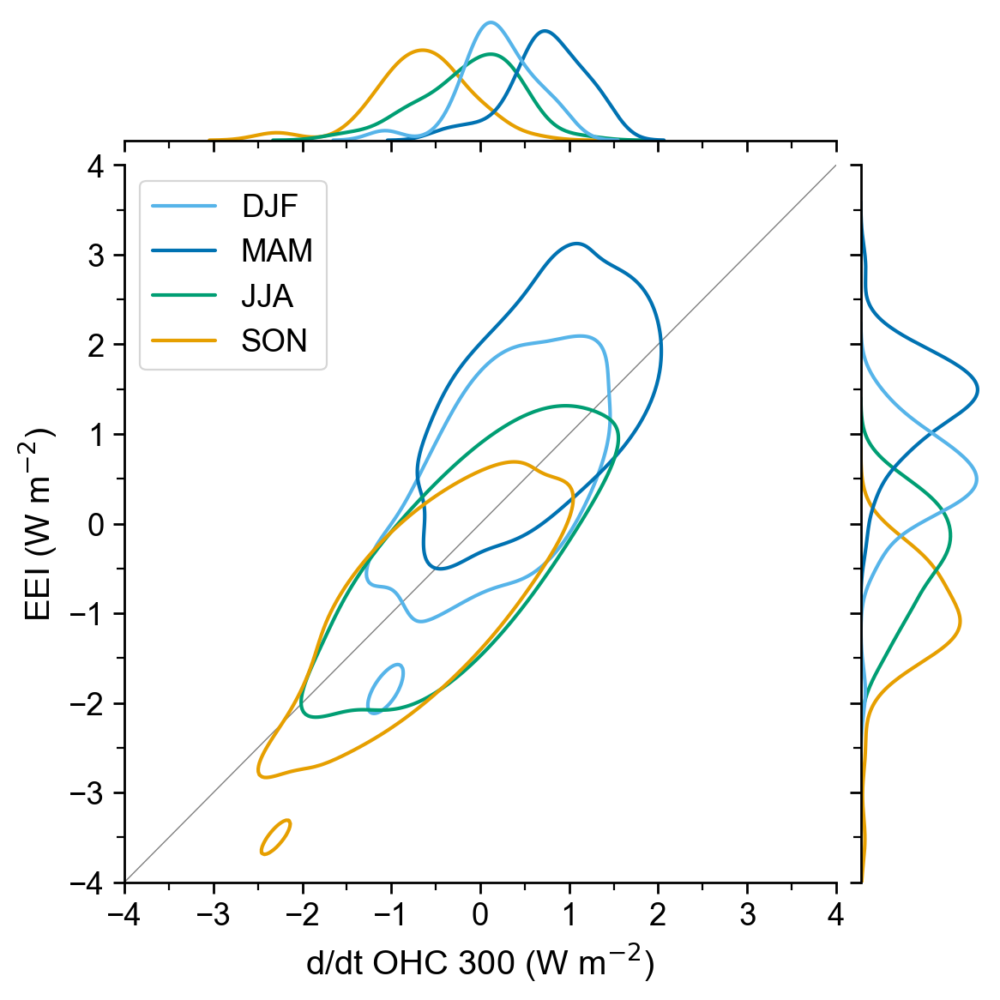

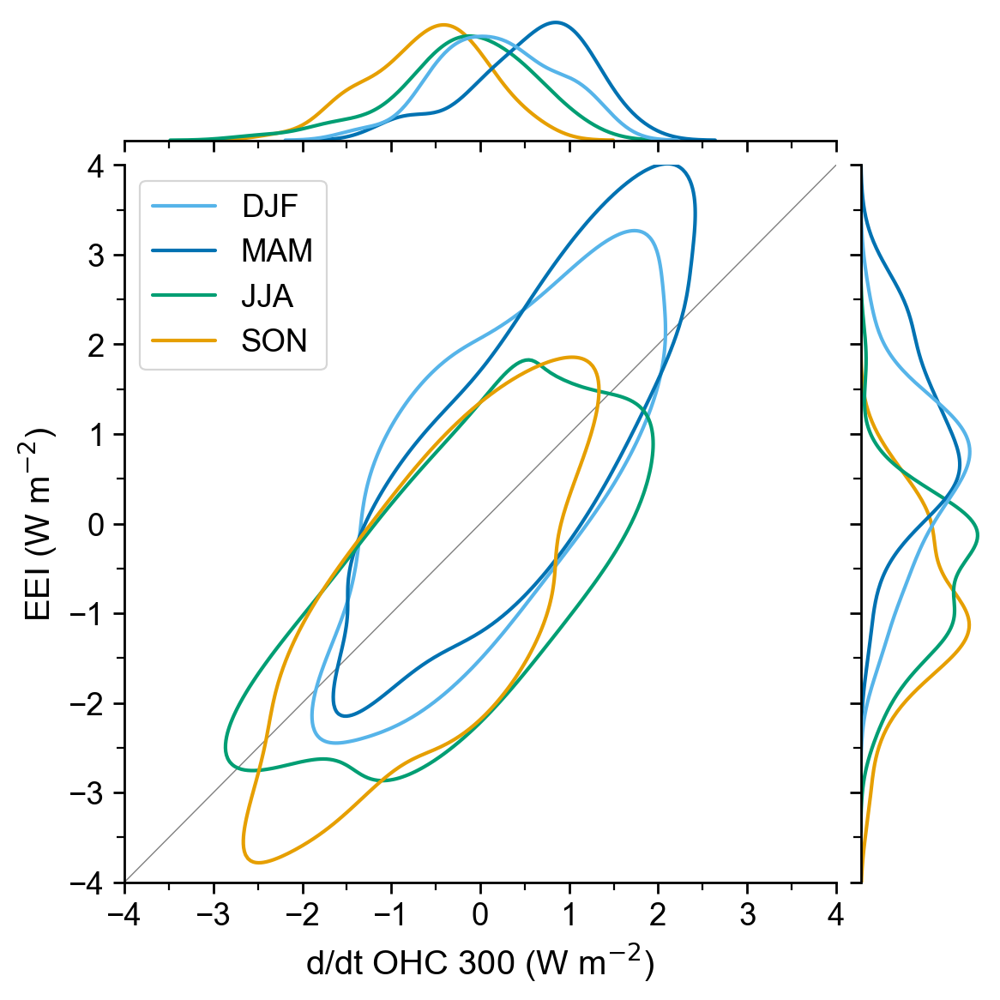

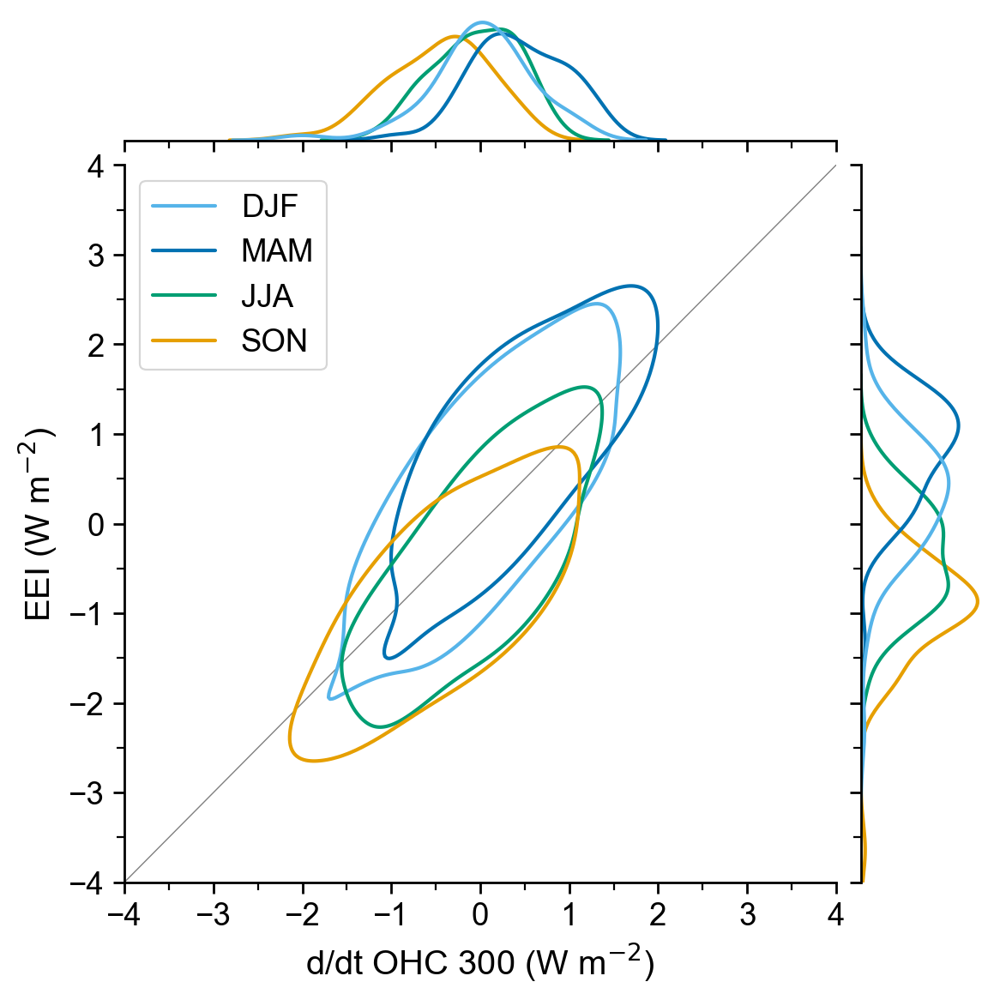

In [ ]:
def plot_ohc_eei_scatter_by_season(ds):
    x = area_weighted_mean(ds)
    x = anomalize(x, (850, 1850))
    x = x.sel(time=slice(1850, 1900)).chunk(time=200)
    x["ddtohc300"] = x["ohc300"].differentiate("time") / SECONDS_PER_YEAR * OCEAN_FRACTION
    x = use_tuple_time_coords(x)
    
    df = pd.DataFrame({
        "ddtohc300": np.concatenate([
            x.sel(season=Season.DJF)["ddtohc300"].values,
            x.sel(season=Season.MAM)["ddtohc300"].values,
            x.sel(season=Season.JJA)["ddtohc300"].values,
            x.sel(season=Season.SON)["ddtohc300"].values,
        ]),
        "eei": np.concatenate([
            x.sel(season=Season.DJF)["eei"].values,
            x.sel(season=Season.MAM)["eei"].values,
            x.sel(season=Season.JJA)["eei"].values,
            x.sel(season=Season.SON)["eei"].values,
        ]),
        "season": (["DJF"] * (len(x.sel(season=Season.DJF)["ddtohc300"].values)) +
                ["MAM"] * (len(x.sel(season=Season.MAM)["ddtohc300"].values)) +
                ["JJA"] * (len(x.sel(season=Season.JJA)["ddtohc300"].values)) +
                ["SON"] * (len(x.sel(season=Season.SON)["ddtohc300"].values)))
    })
    print(df.groupby("season").corr().iloc[0::2,-1])

    vmax = 4
    from cycler import cycler
    with mpl.rc_context({'legend.borderpad': 0.4, 'axes.prop_cycle': cycler(color=["#E69F00", "#56B4E9", "#009E73", "#0072B2"])}):
        g = sns.jointplot(data=df, x="ddtohc300", y="eei", hue="season", kind="kde",
                        joint_kws={"levels": 2},
                        xlim=(-vmax, vmax), ylim=(-vmax, vmax),
                        palette=["C1", "C3", "C2", "C0"],
                        height=6, bw_adjust=1.5)
    
    ax = g.ax_joint
    # ax.set_aspect("equal")
    ax.get_legend().set_title(None)
    ax.plot([-vmax, vmax], [-vmax, vmax], c="black", lw=0.5, alpha=0.5, zorder=-3)
    ax.set_ylabel(f"EEI ({get_field_unit('eei')})")
    ax.set_xlabel(f"d/dt OHC 300 ({get_field_unit('eei')})")
    ax.tick_params(which="both", left=True, bottom=True)
    ax.set_xticks(np.arange(-vmax, vmax+0.1, 1))
    ax.set_yticks(np.arange(-vmax, vmax+0.1, 1))
    ax.set_xticks(np.arange(-vmax, vmax+0.1, 0.5), minor=True)
    ax.set_yticks(np.arange(-vmax, vmax+0.1, 0.5), minor=True)

    ax = g.ax_marg_x
    ax.tick_params(which="both", bottom=True)
    ax.set_xticks(np.arange(-vmax, vmax+0.1, 0.5), minor=True)

    ax = g.ax_marg_y
    ax.tick_params(which="both", left=True)
    ax.set_yticks(np.arange(-vmax, vmax+0.1, 0.5), minor=True)

print(models[0])
plot_ohc_eei_scatter_by_season(dss_anom[0])
print(models[1])
plot_ohc_eei_scatter_by_season(dss_anom[1])
print(models[2])
plot_ohc_eei_scatter_by_season(dss_anom[2])
# print(models[3])
# plot_ohc_eei_scatter_by_season(dss_anom[3])